<a href="https://colab.research.google.com/github/giannisky/Complex-Systems/blob/main/Gianni_Sims_Complex_Systems_Final_Convolution%2C_CA%2C_%26_PDE_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Watch:** Never Say Never - Documentary on Belousov–Zhabotinsky Reaction BZ

https://www.youtube.com/watch?v=FvXwVZPOoBI


In [ ]:
import numpy as np #package to do various mathematical computations
from skimage import io as io #this imports the io submodule from the skimage package and renames it as io in the current namespace
#the package skimage represents a collection of algorithms for image processing
import matplotlib.pyplot as plt #this is to plot various graphs
from scipy import signal #the signal package that is from SciPy is a module for signal processing where it provides various functions and tools for
                        #working with signals such as filtering spectral analysis, and convolution
import torch.nn.functional as F #PyTorch is an open-source machine learning library used for deep learning tasks such as neural networks.
                  #torch.nn is a module within PyTorch that provides tools for building neural networks.
                  #The functional submodule (torch.nn.functional) within torch.nn contains various functions that
                  # (cont sentence) are commonly used in neural network layers, loss functions, and other operations.
                  #Importing torch.nn.functional as F allows you to access these functions using the alias F.
                  #This is a common convention in PyTorch code to make the code more concise and readable.
from torch.nn.functional import * #The line from torch.nn.functional import * imports all functions
                                  # (cont sentence) and submodules from the torch.nn.functional module into the current namespace.
                                  #this is usually preferable for shorter code
import torch #gain access to all the functionality provided by PyTorch, including tensor operations, neural network modules,
            # (cont sentence) optimization algorithms, and utilities for data loading and transformation.
import torch.nn as nn #imports the torchvision package into your Python script or environment.
#Torchvision is a PyTorch library that provides tools and utilities for computer vision tasks, such as image loading, transformation, and dataset management.
#It's commonly used in conjunction with PyTorch for building and training deep learning models for image-related tasks.
import torchvision #Torchvision is a PyTorch library that provides tools and utilities for computer vision tasks, such as image loading, transformation,
                  #and dataset management.
                  #It's commonly used in conjunction with PyTorch for building and training deep learning models for image-related tasks.
import torchvision.transforms as transforms #this submodule provides a collection of common image transformations that can be applied to PIL images or tensors
import time #provides various time-related functions, allowing you to work with time in your Python code.
from matplotlib import animation, rc #allow access for animations to occur
from IPython.display import HTML #allow images
rc('animation', html='html5') #it is configuring the way animations are displayed when using Matplotlib's animation rule

In [ ]:
#1
def make_ani(A, colormap='gray'):

    fig, ax = plt.subplots()
    im = ax.imshow(A[0,:,:], cmap = colormap);
    ax.axis('off')
    fig.set_size_inches(12, 12)

    def animate(data, im):
        im.set_data(data)

    def step():
        for i in range(A.shape[0]):
            data = A[i,:,:]
            yield data

    return animation.FuncAnimation(fig, animate, step, interval=100, repeat=True, fargs=(im,))

#1
A function is being defined. This code defines the function 'make_ani' that creates an animation of some arbitrary matrix, A, which then creates a visual representation of how the data changes over time. In a more detailed description:

3D NumPy Array (A): The input to the function is a 3D NumPy array A, which represents a collection of 2D images or frames. The dimensions of A are [num_frames, height, width], where num_frames represents the number of frames in the animation, and height and width represent the dimensions of each frame.

Subplots: The function uses plt.subplots() to create a single figure (fig) containing a single subplot (ax). This subplot will display the animation.

imshow(): The ax.imshow() function is used to display the initial frame of the animation (A[0,:,:]). This function creates an image plot of the 2D array, with values mapped to colors using the specified colormap (colormap).

Axis Configuration: ax.axis('off') is used to turn off the axes for the subplot, making the animation plot cleaner.

Animation Function (animate): This is a nested function within make_ani. It updates the data displayed by the image plot (im) to the input data.

Generator Function (step): This function generates the data for each frame of the animation. It iterates over the slices of A along the first dimension (A[i,:,:]) and yields each slice one by one.

animation.FuncAnimation: This function is used to create the animation. It takes the figure (fig), the animation function (animate), the generator function (step), and additional parameters such as the update interval (interval) and whether to repeat the animation (repeat). The fargs parameter is used to pass additional arguments (im) to the animate function.

This code arranges the creation of an animation from a sequence of 2D arrays, where they typically represent frames of an image sequence

In [ ]:
#2
def plot(x):
    fig, ax = plt.subplots()
    im = ax.imshow(x, cmap = 'gray')
    ax.axis('off')
    fig.set_size_inches(8, 8)
    plt.show()

#2
Once the function is defined, then the plot can be defined where it visualizes a 2D array 'x' as an image plot:

2D NumPy Array (x): The input to the function is a 2D NumPy array x. This array represents an image, where each element corresponds to the intensity or color value of a pixel.

Subplots: The function uses plt.subplots() to create a single figure (fig) containing a single subplot (ax). This subplot will display the image plot.

imshow(): The ax.imshow() function is used to display the 2D array x as an image plot. This function creates an image plot of the 2D array, with values mapped to colors using the specified colormap ('gray' in this case).

Axis Configuration: ax.axis('off') is used to turn off the axes for the subplot, making the image plot cleaner.

Figure Size: fig.set_size_inches(8, 8) sets the size of the figure (fig) to be 8x8 inches.

Show Plot: plt.show() displays the plot on the screen.

This code generates a grayscale image from a 2D array facilitating visual analysis of its spatial distribution and patterns

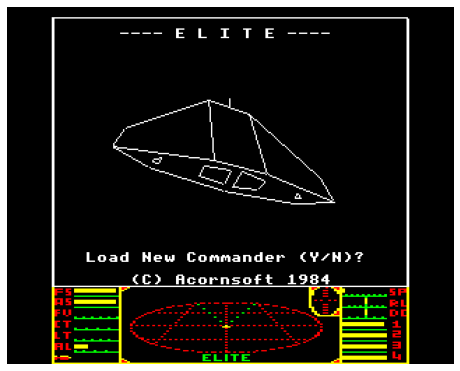

In [ ]:
#Here is an existing image available in the link below and then that image is plotted/processed
image = io.imread("https://www.filfre.net/wp-content/uploads/2013/12/bbc4.png") #image is read from the specified URL using the io.imread() function from the skimage library.
#The URL points to an image hosted online.
plot(image) #image is plotted

This image is originally coming from the following website: https://www.filfre.net/wp-content/uploads/2013/12/bbc4.png and it is being processed and plotted here

In [ ]:
#This represents the shape of the image. For a color image, the shape would return a tuple like height, width, and channels
#channels is the number of color channels
image.shape

(512, 640, 4)

In [ ]:
#3x3 matrix is created and defined
a = np.matrix([[1,2,1],[0,0,0],[-1,-2,-1]])

In [ ]:
a #matrix is printed

matrix([[ 1,  2,  1],
        [ 0,  0,  0],
        [-1, -2, -1]])

In [ ]:
#taking a 3D array and calculates the mean along the third axis which results in a 2D array
image = np.mean(image, axis=2)

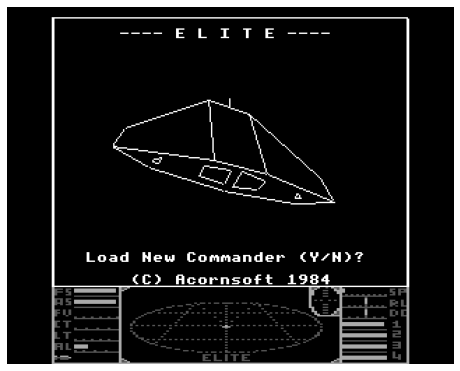

In [ ]:
#image is plotted
plot(image)

For this image: a grayscale image is plotted by applying a Sobel filter to detect edges in the input image, converts the image to grayscale, and then displays it.

In [ ]:
#This represents the shape of the image. For a grayscale image, it would return a tuple of height and width of the image in pixels
image.shape

(512, 640)

In [ ]:
#3
y = signal.convolve2d(image, a, mode='same')

#3
A 2D convolution operation on the image using the kernel 'a' has been made. Resulting in a new image 'y'

More specifically:

signal: This refers to the signal module from the scipy library, which provides various signal processing functions. In this case, it seems like signal has been imported previously, likely as import scipy.signal as signal.

convolve2d: This is a function from the signal module that performs a 2-dimensional convolution operation between two arrays. In this case, it convolves the input image with the kernel a.

image: This is the input image, represented as a 2-dimensional array (presumably a NumPy array).

a: This is the convolution kernel, represented as a 2-dimensional array (also presumably a NumPy array). The convolution operation involves sliding this kernel over the input image and computing the weighted sum of the overlapping pixels at each position.

mode='same': This parameter specifies the mode of the convolution operation. In this case, 'same' mode means that the output y will have the same size as the input image, and elements near the edges of the input will be padded as needed to achieve this.

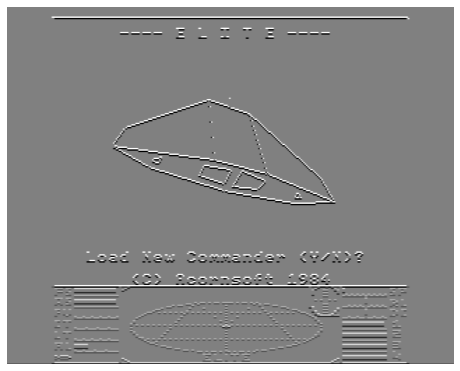

In [ ]:
#plot image
plot(y)

For this image above: the code applies a filter to the input image using convolution and plots which results in this image being processed after the convolution operation

In [ ]:
#matrix is transposed
a = np.transpose(a)

In [ ]:
a

matrix([[ 1,  0, -1],
        [ 2,  0, -2],
        [ 1,  0, -1]])

In [ ]:
#do the same method with convolution but now matrix a is transposed
y = signal.convolve2d(image, a, mode='same')

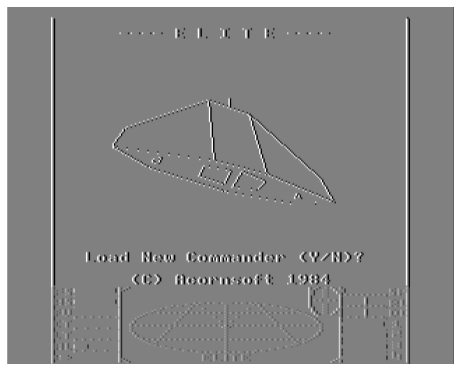

In [ ]:
#make plot
plot(y)

For this image: the code transposes a filter and applies it to the input image using convolution, then after the convolution operation, it plots the resulting image

# Random Filters

In [ ]:
b = np.random.random((25,25)) #random pixels are chosen

In [ ]:
y = signal.convolve2d(image, b) #convolution from that random choice

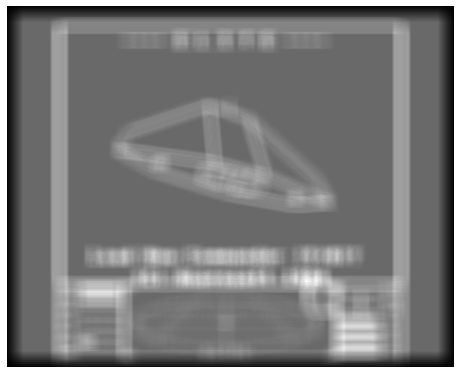

In [ ]:
plot(y) #plot image

For this image:  the code creates a random filter, applies it to the input image using convolution, and plots the resulting image after convolution operation

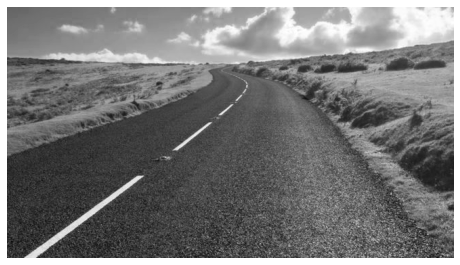

In [ ]:
#another existing image is defined.
x = io.imread("https://ichef.bbci.co.uk/news/660/cpsprodpb/C342/production/_88068994_thinkstockphotos-493881770.jpg")
x = x[:,:,0] #selects only the first channel of the image. It's assuming that the image is in RGB format, where the first channel
# (sentence cont) corresponds to the red channel, the second channel to the green channel, and the third channel to the blue channel.
#By selecting only the first channel (x[:,:,0]), the image is effectively converted to grayscale.
x = x.astype(float) #converts the data type of the array to float.
#It's common to work with floating-point numbers when performing numerical computations.
x /= 255.0 #this line normalizes the pixel values of the image to the range [0,1]
plot(x) #resulting image is plotted

For resulting image: the code will read the image, convert it to grayscale, normalizes the pizel value, and plots the grayscale image

# Double Loop Version of Convolution

In [ ]:
#4
def conv2(x,f):
    x2 = np.zeros(x.shape)
    for i in range(1,x.shape[0]-1):
        for j in range(1,x.shape[1]-1):

            x2[i,j] = f[0,0] * x[i-1,j-1]  \
            +         f[0,1] * x[i-1,j]    \
            +         f[0,2] * x[i-1,j+1]  \
            +         f[1,0] * x[i,j-1]    \
            +         f[1,1] * x[i,j]      \
            +         f[1,2] * x[i,j+1]    \
            +         f[2,0] * x[i+1,j-1]  \
            +         f[2,1] * x[i+1,j]    \
            +         f[2,2] * x[i+1,j+1]

    return x2

#4
This code is defining a function as 'conv2' that will perform a 2D convolution operation on a given input image 'x' using a specified kernel 'f'. More specifically:

Function Definition: The function conv2 takes two arguments, x (the input image) and f (the convolution kernel).

Initialization: It initializes an output array x2 of the same shape as the input image x but filled with zeros.

Nested Loops: It iterates over the indices of the input image x using nested loops. The loops run from 1 to x.shape[0] - 1 for rows and 1 to x.shape[1] - 1 for columns. This ensures that the convolution operation is applied only to the interior pixels of the image, avoiding edge cases where the kernel would extend beyond the boundaries of the image.

Convolution Operation: For each pixel at position (i, j) in the input image, the code calculates the weighted sum of the pixel values in the neighborhood of (i, j) using the convolution kernel f. This is achieved by multiplying each element of the kernel f by the corresponding pixel value in the neighborhood of (i, j) and summing up the results. The result is stored in the corresponding position (i, j) of the output array x2.

Boundary Handling: It's worth noting that this code does not handle boundary cases explicitly. Pixels on the edges of the image (with indices 0 or x.shape - 1) are not considered in the convolution operation. This is a common simplification for illustrative purposes, but in practice, additional handling (e.g., padding) is typically required to handle boundary pixels.

Return Statement: Finally, the function returns the resulting array x2, which represents the output of the convolution operation applied to the input image x with the given kernel f.

in short: conv2 computes the 2D convolution between an input image and a filter/kernel by sliding the filter over the image and computing the weighted sum of pixel values in the neighborhood of each pizel

In [ ]:
a = np.matrix([[-1,-1,-1],[-1,8,-1],[-1,-1,-1]]) #a matrix is defined
# a = np.matrix([[1,2,1],[0,0,0],[-1,-2,-1]])
# a = np.matrix([[1,1,1],[1,1,1],[1,1,1]])
# a = 5*np.random.random((3,3))-5*np.random.random((3,3))

In [ ]:
a #print the matrix

matrix([[-1, -1, -1],
        [-1,  8, -1],
        [-1, -1, -1]])

In [ ]:
z = conv2(x,a) #a 2D convolution is defined as z

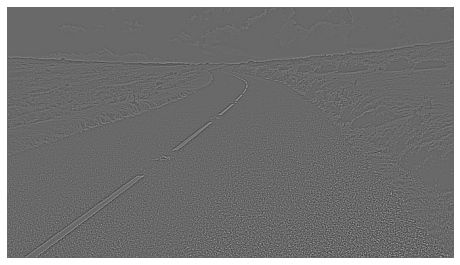

In [ ]:
plot(z) #z is plotted as an image

For this image: the code applies a Laplacian filter to the input image 'x' using convolution and plots the resulting image after convolution operation.

[[-0.66952986  0.79424399 -0.4348661 ]
 [ 0.17020645  0.38741101  0.61432049]
 [ 0.96050993 -0.24662796  0.46796689]]


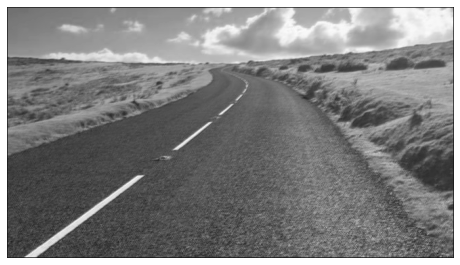

[[ 0.78728906 -0.95588092  0.46325936]
 [ 0.64229245  0.43380599  0.75670135]
 [-0.35835038 -0.4290082  -0.31024244]]


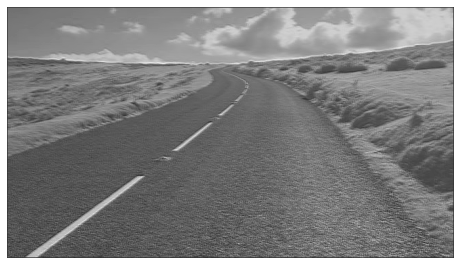

[[ 0.60956206  0.60836907 -0.63880022]
 [ 0.13817797  0.34490083  0.32441134]
 [ 0.99712004 -0.51674677 -0.93735991]]


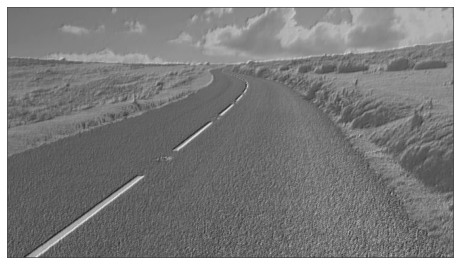

[[-0.33746533 -0.03088352 -0.83817909]
 [ 0.5746849  -0.11854177  0.54468082]
 [ 0.03446952 -0.41638053 -0.68612043]]


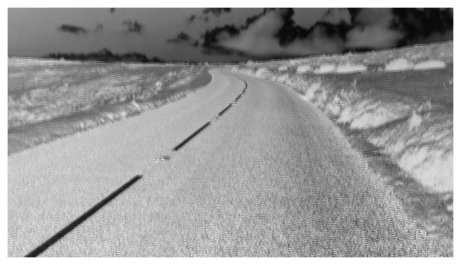

[[-0.63072315  0.6780739  -0.0811398 ]
 [-0.09692524  0.57423134 -0.53382592]
 [-0.43609595 -0.23509658 -0.75925847]]


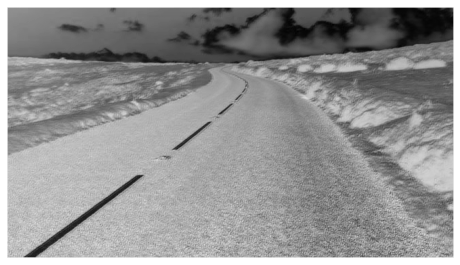

[[-0.56247965 -0.66767808 -0.85766956]
 [-0.97022755 -0.69844918  0.28076051]
 [ 0.32101753 -0.84974194  0.21732662]]


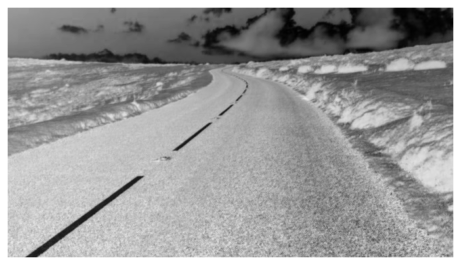

[[ 4.63063036e-01  7.40618142e-01 -9.68351104e-01]
 [-1.74811764e-01 -5.89380734e-01  2.76150950e-02]
 [-9.52891578e-04  1.48191295e-01 -5.75660695e-01]]


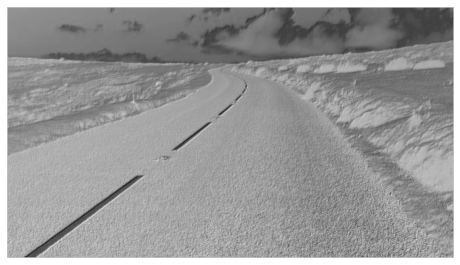

[[-0.80430303  0.10176995  0.84813746]
 [ 0.41339054 -0.91925013  0.1577482 ]
 [ 0.35009427 -0.28459231 -0.97338147]]


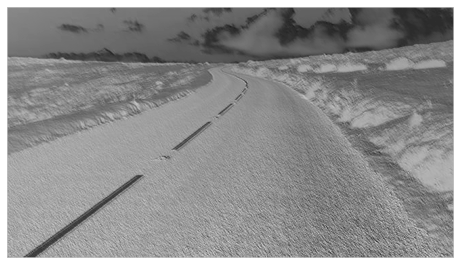

[[-0.00696977  0.73440475  0.50623494]
 [-0.24445755 -0.78406643  0.44425609]
 [-0.79681422 -0.87784548  0.21854638]]


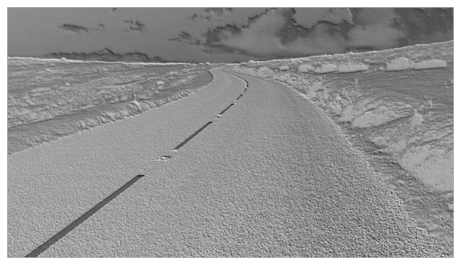

[[ 0.23440823  0.80947263 -0.58662717]
 [-0.40642747 -0.03255374  0.34291434]
 [-0.32066709 -0.93038173 -0.19752208]]


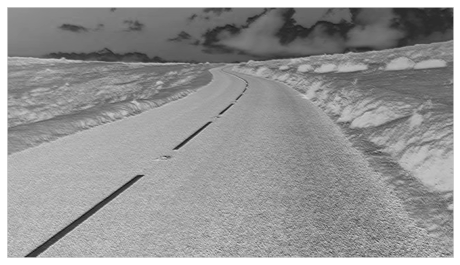

[[ 0.79587438 -0.66303714  0.00215259]
 [-0.2011224   0.33804103 -0.88351297]
 [-0.86831793  0.3231647   0.3257212 ]]


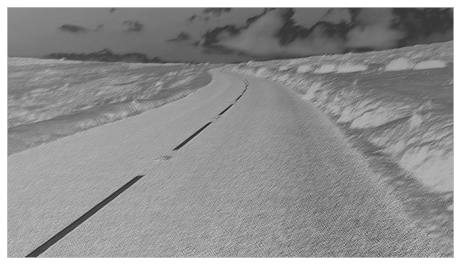

[[-0.77738256 -0.5984036  -0.71212143]
 [-0.92238724 -0.73610379 -0.00594657]
 [-0.61272143 -0.26461509  0.52364034]]


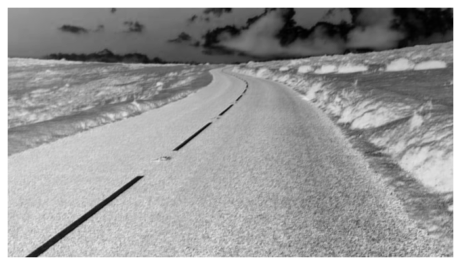

[[ 0.22728915 -0.18856513  0.0691582 ]
 [-0.04907951  0.96827625 -0.23889663]
 [-0.45803616 -0.39267182  0.31464545]]


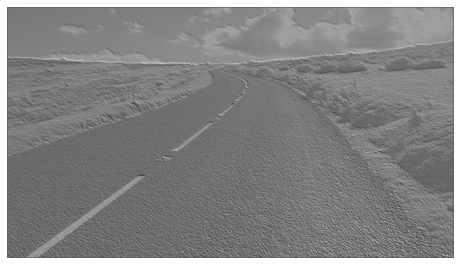

[[-0.5755608   0.38671536  0.45220511]
 [-0.7738876  -0.62616835 -0.3612181 ]
 [ 0.58838434 -0.4304329   0.75962425]]


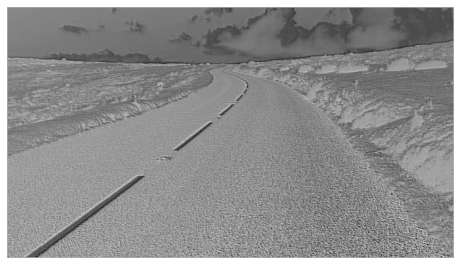

[[-0.99676093 -0.19446194 -0.37548923]
 [-0.8996256   0.30930444  0.59838882]
 [-0.95607926 -0.8208889   0.34327036]]


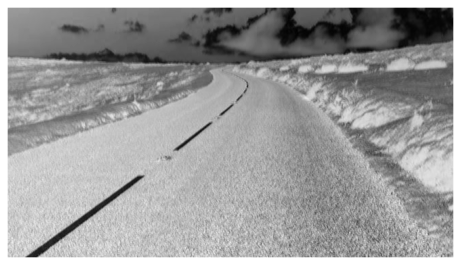

[[ 0.16616992  0.26368749 -0.30366241]
 [-0.11918478 -0.57833161 -0.98580788]
 [ 0.53545429  0.05897644  0.96347823]]


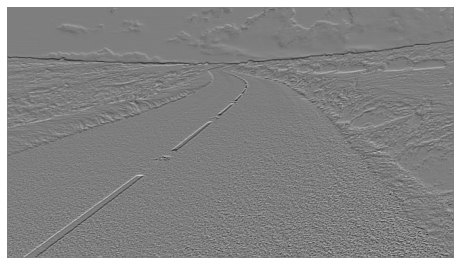

[[-0.21190825  0.76922125  0.63421423]
 [-0.54285788 -0.79604549  0.46676108]
 [ 0.54726269 -0.7274512  -0.14973126]]


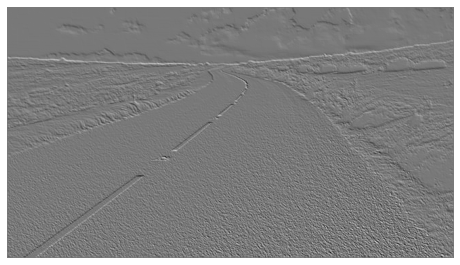

[[-0.04385939  0.75952718 -0.79370485]
 [-0.11300101  0.24001398 -0.52783214]
 [ 0.36803143 -0.67214736 -0.77309757]]


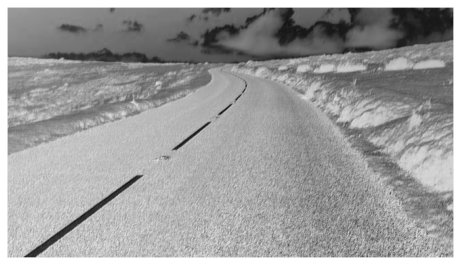

[[-0.70720816 -0.48677671 -0.26063011]
 [ 0.29927926  0.72058057 -0.4646972 ]
 [-0.54763458  0.87307967 -0.37936532]]


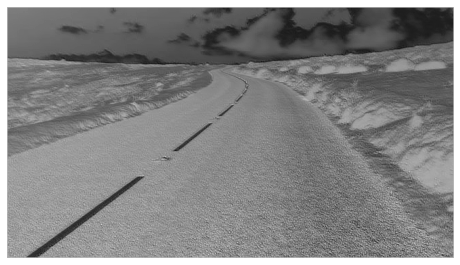

[[-0.52663085  0.96444791 -0.05328948]
 [-0.97731512 -0.42077658 -0.15798646]
 [-0.57204271  0.61668313  0.72743774]]


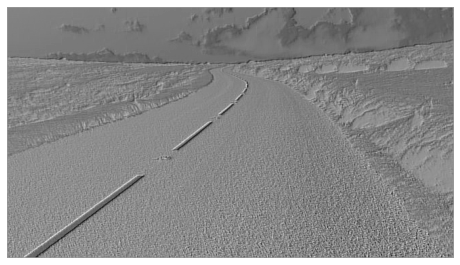

[[-0.07912375 -0.36593686  0.51700994]
 [ 0.6746482   0.84186512  0.29442479]
 [-0.19919652 -0.15450657  0.5762957 ]]


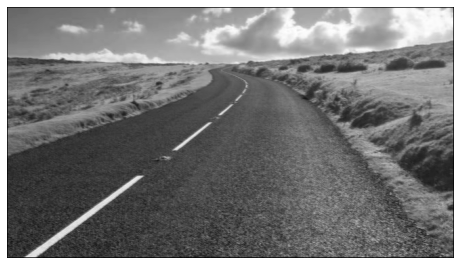

[[ 0.88402446  0.52994672  0.33212924]
 [-0.04769775 -0.42405942 -0.71273553]
 [ 0.6823777  -0.72945914 -0.57310794]]


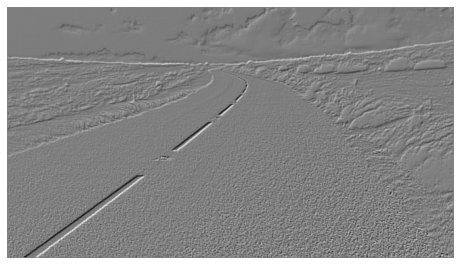

[[-0.76977139  0.17213117  0.2346618 ]
 [-0.37208609  0.31172762  0.30368557]
 [ 0.51160623  0.18941009  0.59009627]]


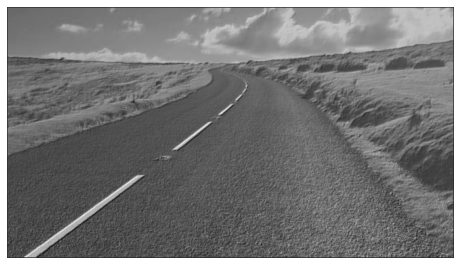

[[ 0.74024445  0.77085538 -0.89101216]
 [-0.41453354  0.43975792  0.76289709]
 [-0.66148197  0.19953202  0.69393954]]


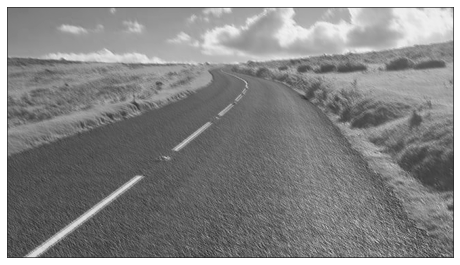

[[ 0.89654269  0.06974101 -0.02639035]
 [-0.56817358  0.0947248  -0.83800687]
 [ 0.50640838 -0.3929656  -0.8515142 ]]


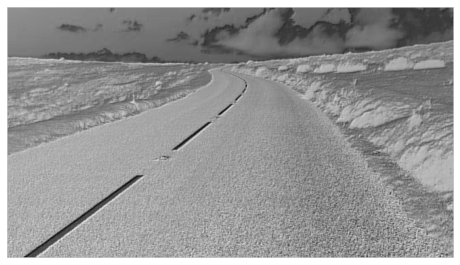

[[-0.56781713 -0.41641424 -0.42466816]
 [-0.45669334 -0.18812147  0.74238262]
 [-0.01134254  0.55292415  0.25803291]]


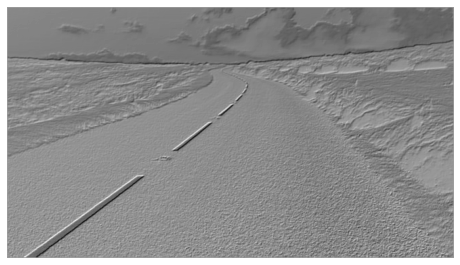

[[-0.06334353 -0.65782947  0.18062716]
 [-0.74919577 -0.64883052 -0.79765102]
 [ 0.32089363  0.98449484  0.85165873]]


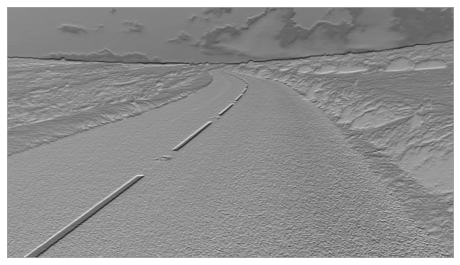

[[ 0.1435398  -0.77946864 -0.2358403 ]
 [ 0.46514865 -0.81477105 -0.83674168]
 [ 0.3382429   0.82423165  0.15593196]]


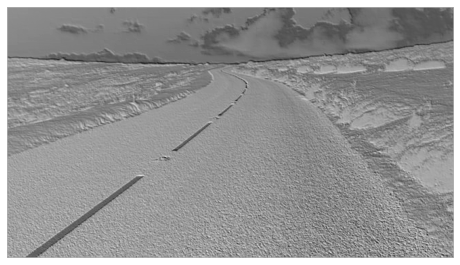

[[ 0.93529786  0.31168682 -0.24102269]
 [ 0.10168729  0.39700391 -0.77525696]
 [-0.25804187  0.9072545  -0.11694869]]


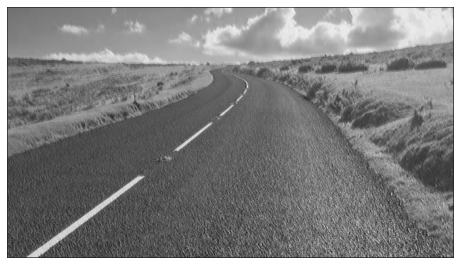

[[ 0.40076968  0.09948869  0.99677197]
 [-0.13946964 -0.77394891 -0.79775784]
 [ 0.81316873 -0.41076618 -0.11360797]]


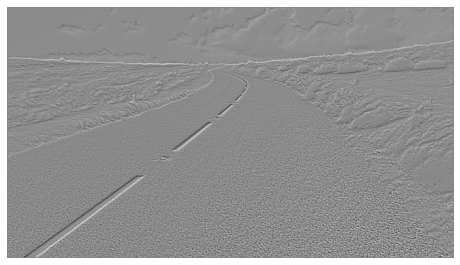

In [ ]:
#this for loop is generating a 3x3 matrix 'a'  with values beterrn -1 and 1
#prints random generated a matrix
#performs 2D convolution operation
#plots the resulting convolved image
for i in range(30):
    a = 2*np.random.random((3,3))-1
    print(a)
    z=conv2(x,a)
    plot(z)

In [ ]:
#For this image above, this loop effectively applies 30 different random filters to the input image and visualizes the resulting image

# Timing Loops

In [ ]:
#Homemade Conv Loop Timing
#this is generating a random set of 9 convolution kernels, represented as a 3x3 matrix with values between -1 and 1
#each of these kernels are iterated
#For each kernel, applies a 2-dimensional convolution operation (conv2) to the input image x using the current kernel.
#Measures the total time taken for all convolution operations.
a = 2*np.random.random((9,3,3))-1
start_time = time.time()
for i in range(9):

    z=conv2(x,a[i,:,:])

print("--- %s seconds ---" % (time.time() - start_time))

--- 7.159096002578735 seconds ---


In [ ]:
#Optimized Code Timing
#task is similar but the difference is that it utilizes 'signal.convolve2d' from the scipy library.
a = 2*np.random.random((9,3,3))-1  #The line a = 2*np.random.random((9,3,3))-1 generates a random set of 9 convolution kernels.
start_time = time.time()
for i in range(9):
#inside the loop, for each kernel a[i,:,:], the line z = signal.convolve2d(x,a[i,:,:]) applies a 2-dimensional
  #convolution operation to the input image x using the current kernel
    z = signal.convolve2d(x,a[i,:,:])

print("--- %s seconds ---" % (time.time() - start_time)) #the difference between the current time (time.time()) and the start time (start_time) gives the elapsed time for all convolution operations.

--- 0.08623218536376953 seconds ---


In [ ]:
#5
#GPU Processing Timing, No Loop, 96 filters!!
#This code segment involves performing a 2D convolution operation using PyTorch on a CUDA-enabled GPU.
a2 = 2*np.random.random((96,1,3,3))-1
x2 = torch.tensor(x).cuda()
a2 = torch.tensor(a2).cuda()
x2 = x2[None,None,:,:]

start_time = time.time()
z = conv2d(x2,a2) #the 2D convolution is defined as z
print("--- %s seconds ---" % (time.time() - start_time))

--- 7.970189332962036 seconds ---


#5
Random Kernel Generation: The line a2 = 2*np.random.random((96,1,3,3))-1 generates a set of 96 convolution kernels. Each kernel is represented as a 3x3 matrix with three input channels (RGB channels), and there are 96 such kernels.

Data Conversion:

x2 = torch.tensor(x).cuda(): Converts the input image x into a PyTorch tensor and moves it to the GPU (CUDA). This assumes that x is a NumPy array representing an image.
a2 = torch.tensor(a2).cuda(): Converts the randomly generated kernels a2 into PyTorch tensors and moves them to the GPU (CUDA).
x2 = x2[None,None,:,:]: Adds two dimensions to the input tensor x2. This is done to match the expected shape of the input tensor for the convolution operation. The added dimensions are for batch size and number of channels, respectively.
Time Measurement: start_time = time.time() records the start time before performing the convolution operation.

Convolution Operation: z = conv2d(x2, a2) performs a 2D convolution operation (conv2d) using PyTorch. This operation convolves the input image tensor x2 with the set of kernels a2 on the GPU.

Time Measurement (Continued): After the convolution operation is complete, print("--- %s seconds ---" % (time.time() - start_time)) prints the elapsed time taken for the convolution operation.

In short: this code generates random filters, performs a 2D convolution operation on the input tensor, measures the execution time, and prints the time taken for the operation to complete

In [ ]:
z.shape #determine the shape of the convolution image
#This represents the shape of the image. For a color image, the shape would return a tuple like height, width, and channels
#channels is the number of color channels

torch.Size([1, 96, 369, 658])

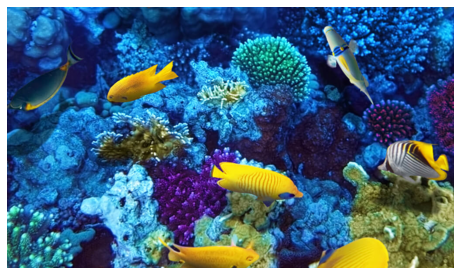

In [ ]:
#original image is read and plotted
image = io.imread("http://harborparkgarage.com/img/venues/pix/aquarium2.jpg").astype(float)/255.0
plot(image)

This image is originally coming from the following website: http://harborparkgarage.com/img/venues/pix/aquarium2.jpg and it is being processed and plotted here

In [ ]:
#This represents the shape of the image. For a color image, the shape would return a tuple like height, width, and channels
#channels is the number of color channels
image.shape

(599, 1024, 3)

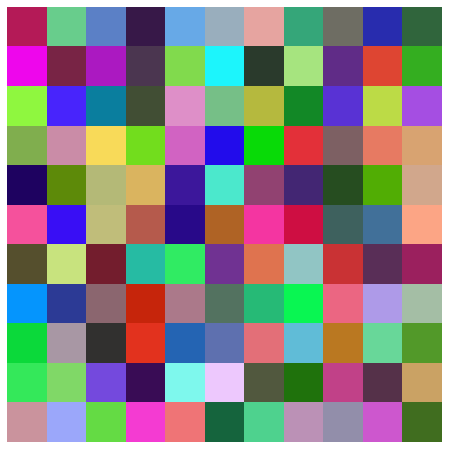

In [ ]:
#generates a random RGB image with dimensions of 11 x 11 pixels and then visualizes it using a plotting function 'plot'
plot(np.random.random((11,11,3)))

Generates a random RGB image with dimensions of 11 x 11 pixels and then visualizes it using a plotting function 'plot'

In [ ]:
#the dimensions of the 'image' array is reshaped by rearranging its axis
image = np.transpose(image, (2, 0, 1))

In [ ]:
#generates a 4D array 'f' representing a filter or kernel for convolutional operations
f = np.random.random((1,3,11,11))

In [ ]:
##This represents the shape of the image. For a color image, the shape would return a tuple like height, width, and channels
#channels is the number of color channels
image.shape

(3, 599, 1024)

In [ ]:
#this adds a new axis to the 'image' array effectively changing its shape
image = image[None,:,:,:]

In [ ]:
#these .shapes are used to retrieve the shapes of the numpy arrays 'image' and 'f'
image.shape,f.shape

((1, 3, 599, 1024), (1, 3, 11, 11))

In [ ]:
#this converts the numpy arrays 'f' and 'image' into Pytorch tensors
f =  torch.tensor(f)
image =  torch.tensor(image)

In [ ]:
#its performing a 2D convolution operation on the input image tensor using the filter/kernel tensor
image2 = F.conv2d(image,f)

In [ ]:
#this converts the PyTorch tensor into a numpy array
image2 = image2.numpy()

In [ ]:
#returns a tuple representing the shape of the 4D numpy array
image2.shape

(1, 1, 589, 1014)

In [ ]:
#it retrieves the shape of a subarray of the numpy array 'image2'
image2[0,0,:,:].shape

(589, 1014)

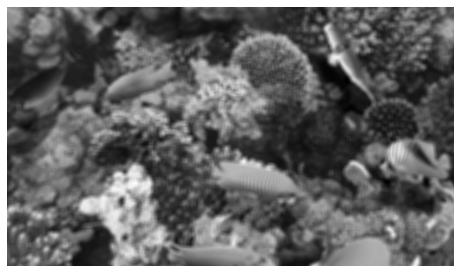

In [ ]:
#visualizes a 2D slice of the numpy array 'image2' assuming that 'plot' is a function that can visualize 2D arrays
plot(image2[0,0,:,:])

This code converts the filter and input images to pytorch tensors, performs a 2D convolution operation using PyTorch's functional module, converts the result back to a NumPy array, and plots the resulting image.

# Convolution as Feature Map

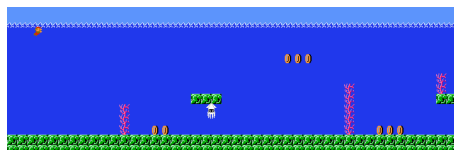

In [ ]:
#new image is read and plotted
image = io.imread("http://ian-albert.com/games/super_mario_bros_maps/mario-2-2.gif")
image = image[:,0:700,:]
plot(image)

This image is originally coming from the following website:http://ian-albert.com/games/super_mario_bros_maps/mario-2-2.gif and it is being processed and plotted here



In [ ]:
#its extracting a region of interest from the original image 'image
coin = image[185:200,224:239,:]

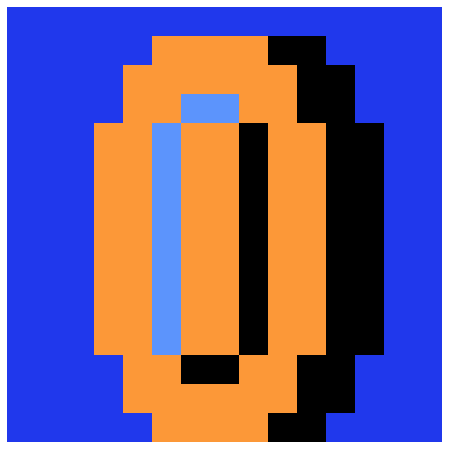

In [ ]:
#image is plotted and shown below
plot(coin)

As described in my commented section, this image displays a subsection or a crop of the orginal image that just shows the coin

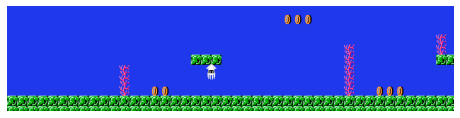

In [ ]:
#this modifies the original image by cropping it to a smaller region of interest
#then it visualizes the cropped image using the 'plot' function
image = image[60:,0:700,:]
plot(image)

This code displays a portion of the original image starting from row 60 and ending at the bottom, and from column 0 to column 699.

In [ ]:
#6
def scale1(x):
    return (x-np.min(x))/(np.max(x)-np.min(x))

#6
This function performs a min-max scaling on the input array 'x'
This scaling is a technique used to rescale the values of the input array to a fixed range, usually between 0 and 1. More specifically:

np.min(x): This function calculates the minimum value of the input array x.

np.max(x): This function calculates the maximum value of the input array x.

(x - np.min(x)): This subtracts the minimum value of x from each element of the array x.

(np.max(x) - np.min(x)): This calculates the range of the values in x by subtracting the minimum value from the maximum value.

(x - np.min(x)) / (np.max(x) - np.min(x)): This performs element-wise division of each value in the array (x - np.min(x)) by the range (np.max(x) - np.min(x)).

The result is that each value in the input array x is scaled linearly such that the minimum value becomes 0 and the maximum value becomes 1. All other values are scaled proportionally between 0 and 1 based on their relative position within the range of values in the input array x.


In [ ]:
#7
image=np.mean(image,axis=2)
coin=np.mean(coin,axis=2)

image=scale1(image)
coin=scale1(coin)

#7
np.mean(image, axis=2): This calculates the mean along the third axis (axis index 2) of the array image. Since image likely represents an image with shape (height, width, channels), this operation computes the mean across the color channels. After this operation, image becomes a 2D array where each element represents the mean intensity value across all color channels for each pixel.

np.mean(coin, axis=2): Similarly, this calculates the mean along the third axis of the array coin. After this operation, coin becomes a 2D array representing the mean intensity value across all color channels for each pixel in the region of interest.

scale1(image): This function call applies min-max scaling to the array image, ensuring that the intensity values are scaled to a range between 0 and 1. This is typically done to normalize the pixel intensities and ensure consistency across different images or regions.

scale1(coin): Similarly, this function call applies min-max scaling to the array coin, ensuring that the intensity values are scaled to a range between 0 and 1.

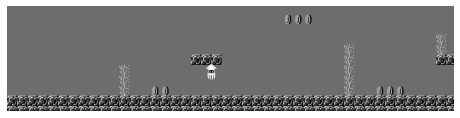

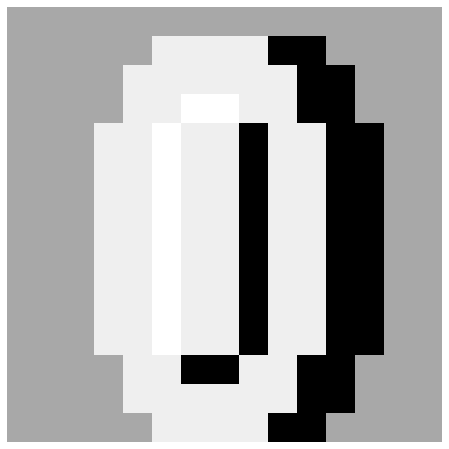

In [ ]:
#both of these images are plotted
plot(image)
plot(coin)

From these two images: the code converts the original image and its cropped region to grayscale, normalizes the pixel values to the range [0, 1], and then plots both images.

In [ ]:
coin.shape #prints height and width of the image of the pixels

(15, 15)

In [ ]:
#the data is being centered by subtracting the image and coin array by its mean
image = image - np.mean(image)
coin = coin - np.mean(coin)

In [ ]:
#the heights and widths of the image of the pixels for both 'image' and 'coin' are being shown
image.shape,coin.shape

((164, 700), (15, 15))

In [ ]:
#this is performing a 2D convolution operation between the 'image' array and a rotated version of the 'coin' array
z = signal.convolve2d(image, np.rot90(coin, 2)) #its defined as z

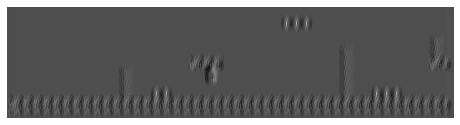

In [ ]:
plot(z) #show the resulting image

For the image above: this code performs a specific operation called convolution between two images, image and coin, or more precisely between image and a modified version of coin obtained by rotating it 180 degrees.

The convolution operation involves sliding the rotated coin over the image and computing the sum of element-wise products at each position. This process highlights regions in the image that match the pattern represented by the rotated coin.

The resulting array z contains the convolution result, which can provide information about similarities or correlations between the image and the rotated coin. The plot of z visualizes these convolution results, potentially revealing features or patterns present in the image.

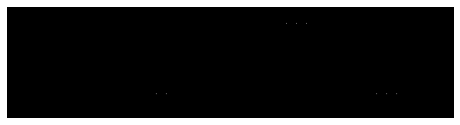

In [ ]:
#this visualizes a binary image where each pixel is set to 'True' if it corresponds to the maximum value in the array 'z'
#Otherwise it'll be 'False'
plot(z==np.max(z))

For the image above: coins are being located by showing the faint white dots. This operation effectively highlights the regions in the z array where the convolution result is maximized, indicating areas in the image where the pattern represented by the rotated coin aligns most closely.

By plotting this binary image, one can easily identify the locations in the original image where the convolution operation produces the strongest response, potentially indicating the presence of significant features or matches between the image and the rotated coin.

In [ ]:
#this finds the coordinates of the maximum value in the array 'z' using numpy's where function
[y,x] = np.where(z == np.amax(z))

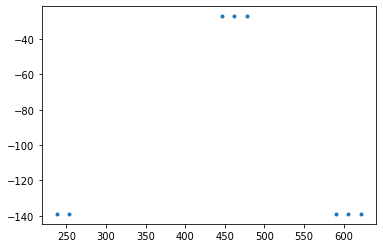

In [ ]:
plt.plot(x,-y,'.')

For the plot above: it's plotting where the coins are

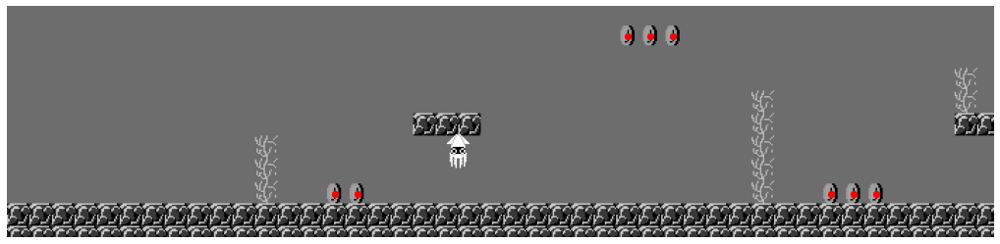

In [ ]:
#grayscale image and location of the coins from the plots are overlapped
fig, ax = plt.subplots()
im = ax.imshow(image, cmap = 'gray')
ax.axis('off') #This removes the axis labels and ticks from the subplot
ax.scatter(x-6, y-6, c='red', s=40) #This adds scatter plot markers to the subplot
fig.set_size_inches(18, 10) #This sets the size of the figure to 18 inches in width and 10 inches in height.

For image above: this code creates a plot showing the grayscale image, hides the axis, adds red scatter points at specified coordinates (with a slight shift), and sets the size of the figure.







#Game of Life

In [ ]:
#8
def conv2(w,f): #GPU conv with padding

    n = conv2d(w.type(torch.int),f.type(torch.int))
    n = pad(n, (1, 1, 1, 1)) #add ones to the sides of the matrix

    return n

#8
This code defines a function that performs a 2D convolution operation with padding using GPU acceleration. More specifically:

def conv2(w,f):: This line defines a function named conv2 that takes two arguments, w and f, which are expected to be tensors.

n = conv2d(w.type(torch.int),f.type(torch.int)): This line performs a 2D convolution operation using the conv2d function with the input tensors w and f. The .type(torch.int) conversion converts the tensors to torch.int data type, which may not be typical for convolution operations. It's unusual to perform convolutions with integer data types as they are typically performed with floating-point data types.

n = pad(n, (1, 1, 1, 1)): This line pads the result of the convolution operation n with ones on all sides of the matrix. The padding is specified as (1, 1, 1, 1), which means one row of ones is added above and below the matrix, and one column of ones is added to the left and right of the matrix. This padding ensures that the output size matches the input size, especially after convolution operations that might reduce the size of the output due to the convolution operation's kernel size and stride.

return n: This line returns the padded result of the convolution operation.

In [ ]:
w = (np.random.random((100,100)) > 0.5) #game of life world grid w
f = np.matrix([[1,1,1],[1,0,1],[1,1,1]])  #this is a kernel or filter for game of life simulation

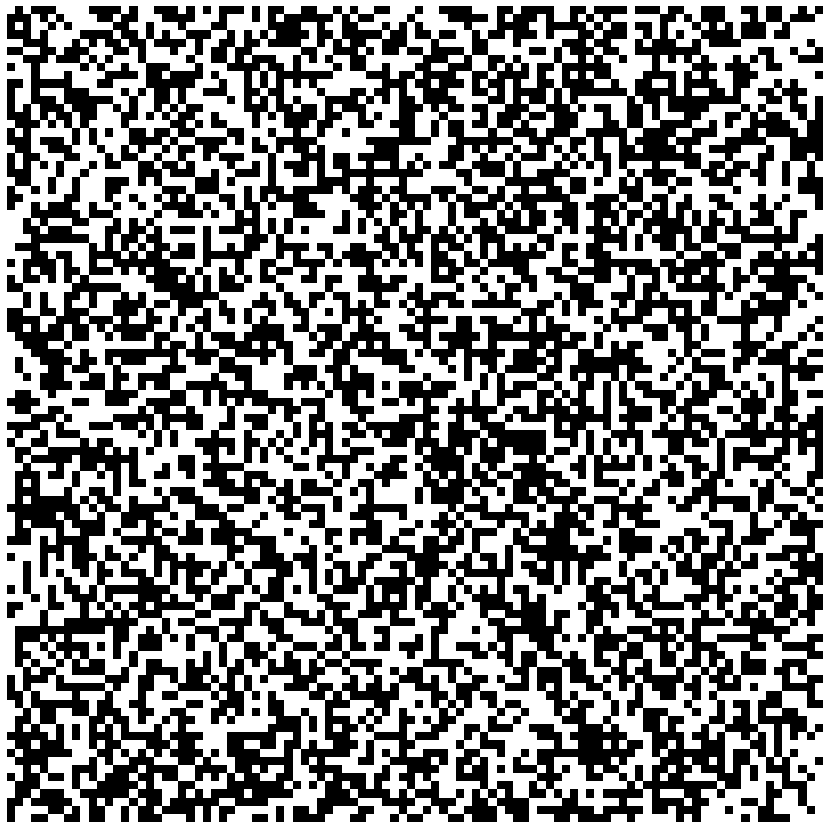

In [ ]:
plot(w) #resulting image is shown and plotted

For the image above: This is the intitial state of the simulation, its visualizing randomly generated arrangement of live and dead cells

In [ ]:
#variables are initialized before performing the simulation
steps = 1000 #sets the number of steps for the simulation
A = torch.zeros((steps,100,100)) # storage for frames for animation
w = torch.tensor(w.astype(int))[None,None,:,:] #this converts 'w' array to a pytorch tensor and adds two additional dimensions
#this is to match batch size and number of channels expected by pytorch's convolution functions
f = torch.tensor(f.astype(int))[None,None,:,:] #this converts the kernel/filter to a pytorch tensor and adds two additional dimensions

In [ ]:
#9
for i in range(steps):

    n = conv2(w,f)

    w = (w * (n==2)) + (n==3)

    A[i] = w


#9
This is performing the simulation for Conway's Game of Life. More specifically:

n = conv2(w, f): This line calculates the next state of the world grid w by performing a 2D convolution operation (conv2) with the kernel/filter f. The result is stored in the variable n, which represents the number of alive neighbors for each cell in the grid.

w = (w * (n==2)) + (n==3): This line updates the world grid w based on the rules of Conway's Game of Life:

Any live cell with two or three live neighbors survives.
Any dead cell with exactly three live neighbors becomes a live cell.
All other cells die or remain dead.

The expression (n==2) creates a boolean array where True indicates cells with exactly two live neighbors, and (n==3) creates a boolean array where True indicates cells with exactly three live neighbors. The expression w * (n==2) preserves live cells with two live neighbors, and (n==3) brings new cells to life where there are exactly three live neighbors. The resulting array represents the updated state of the world grid.

A[i] = w: This line stores the updated state of the world grid w in the i-th frame of the animation tensor A. Each frame represents a snapshot of the world grid at a particular time step.


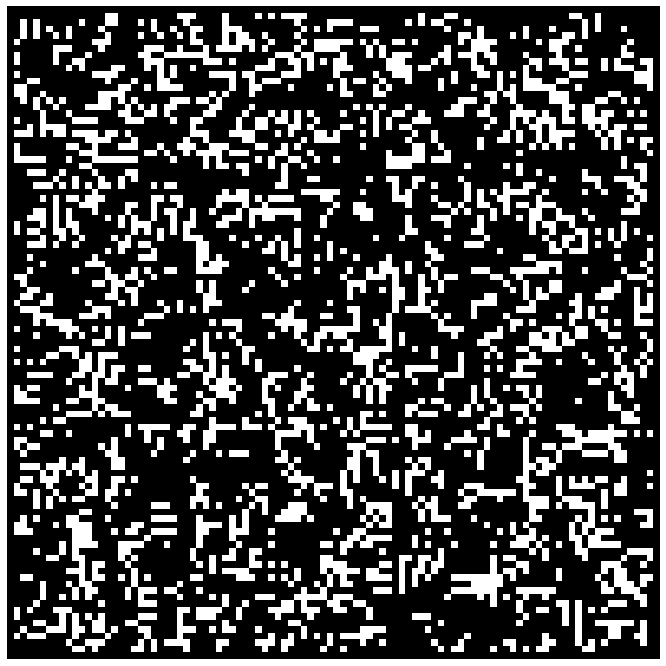

In [ ]:
make_ani(A) #an animation is being made to show/plot the following image/animation

For the image above: The animation represents the dynamic changes of the initial grid

#Surface Tension Model

In [ ]:
w = (np.random.random((100,100)) > 0.5).astype(int) #this is the game of life world grid
#generates a 100x100 array of random numbers between 0 and 1.
#Then it checks if each random number is greater than .5
#his results in a boolean array where approximately half of the values are True and the other half are False.
#The .astype(int) method converts this boolean array to integers, where True is represented as 1 and False as 0.
f = np.matrix([[1,1,1],[1,1,1],[1,1,1]]) #kernel or filter for the simulation.
#it is initialized with a 3x3 matrix
#it represents the Moore neighborhood, which includes the cell itself and its eight adjacent neighbors.

In [ ]:
steps = 10 #sets the number of steps for the simulation to 10
A = torch.zeros((steps,100,100)) # storage for frames for animation
w = torch.tensor(w)[None,None,:,:] #This converts the variable w (presumably representing the initial world grid for the simulation) to a PyTorch tensor.
#The [None, None, :, :] part adds two additional dimensions at the beginning of the tensor.
#his is done to match the expected shape for input tensors in PyTorch's convolution functions.
f = torch.tensor(f)[None,None,:,:]
#this converts the variable f (presumably representing the filter/kernel for the simulation) to a PyTorch tensor and adds two additional dimensions

In [ ]:
#10
for i in range(steps):

    n = conv2(w,f)

    w = ~((n<4) + (n==5))

    A[i] = w

#10
This code performs a simulation of Conway's Game of Life for a specified number of steps (steps).

Here's a breakdown of what happens in each step:

n = conv2(w, f): This line calculates the next state of the world grid w by performing a 2D convolution operation (conv2) with the kernel/filter f. The result is stored in the variable n, which represents the number of alive neighbors for each cell in the grid.

w = ~((n<4) + (n==5)): This line updates the world grid w based on the rules of Conway's Game of Life:

Any live cell with fewer than 4 or more than 5 live neighbors dies due to underpopulation or overpopulation, respectively.
Any dead cell with exactly 5 live neighbors becomes alive due to reproduction.
The expression (n<4) + (n==5) creates a boolean array where True indicates cells that meet either condition. The ~ operator then negates this boolean array, so True becomes False and vice versa. As a result, live cells with fewer than 4 or more than 5 live neighbors, as well as dead cells with exactly 5 live neighbors, are set to False, representing dead cells. All other cells are set to True, representing live cells. This line effectively updates the state of the world grid according to the rules of Conway's Game of Life.
A[i] = w: This line stores the updated state of the world grid w in the i-th frame of the animation tensor A. Each frame represents a snapshot of the world grid at a particular time step.

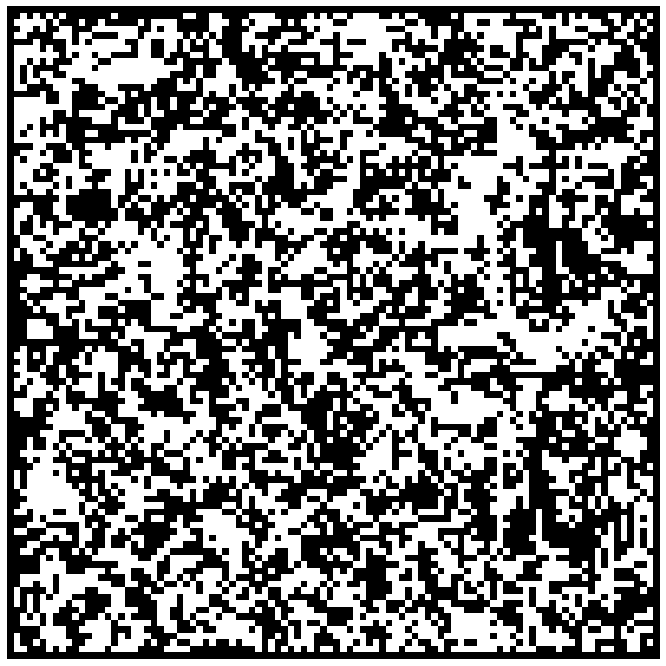

In [ ]:
make_ani(A) #animation is made

# Forest Fire Model

In [ ]:
#This line appears to be a comment explaining the mapping of numerical values to different states in a variable called veg.
#Specifically, it describes how different numeric values are used to represent different states within the variable veg.
# veg = {empty=0 burning=1 green=2}

In [ ]:
#there are several variables being initialized
Plightning = 0.00005 #This sets the probability of a lightning strike.
Pgrowth = 0.01#This sets the probability of vegetation growth

w = (np.random.random((100,100)) > 0.5).astype(int)#This line initializes a 100x100 array representing the initial state of the world grid for the simulation
# Each element of the array is set to 1 if a randomly generated number between 0 and 1 is greater than 0.5
#this indicates the presence of vegetation, and 0 otherwise.
#The .astype(int) method then converts the boolean array to integers, where True is represented as 1 and False as 0.
f = np.matrix([[1,1,1],[1,0,1],[1,1,1]]) #This line initializes a 3x3 matrix representing the filter/kernel for the simulation

steps = 1000 #This sets the number of steps for the simulation to 1000.
A = torch.zeros((steps,100,100)) # storage for frames for animation
w = torch.tensor(w)[None,None,:,:] #This line initializes a tensor A to store frames for animation. It creates a 3-dimensional tensor with a shape of (steps, 100, 100).
f = torch.tensor(f)[None,None,:,:] #This line converts the variable w (presumably representing the initial world grid for the simulation) to a PyTorch tensor and adds two additional dimensions at the beginning.

In [ ]:
#11
for i in range(steps):

    n = w == 1

    n = conv2(n,f)

    w =  2*((w == 2)).type(torch.int)                                                \
    -      ((w == 2) * ( n > 0 ) ).type(torch.int)                                   \
    -      ((w == 2) * ( np.random.random((100,100)) < Plightning)).type(torch.int)  \
    +    2*((w == 0) * ( np.random.random((100,100)) < Pgrowth)).type(torch.int)

    A[i] = w

#11
This code segment appears to simulate the spread of fire ('forest fire') in a vegetation grid based on certain rules for a specified number of steps (steps). Let's break down what happens in each step:

n = w == 1: This line creates a boolean array n where True indicates the presence of burning vegetation (w equal to 1) and False indicates the absence of burning vegetation.

n = conv2(n,f): This line convolves the boolean array n with a filter/kernel f. This convolution operation calculates the number of burning neighbors for each cell in the grid based on the filter f. The resulting array n represents the number of neighboring cells that are currently burning.

The next lines update the state of the vegetation grid w based on certain rules:

2*((w == 2)).type(torch.int): This line first creates an array where True indicates the presence of green vegetation (w equal to 2) and False otherwise. Then, it multiplies each element by 2 to set all cells with green vegetation to a value of 4 (2 multiplied by 2).

((w == 2) * ( n > 0 ) ).type(torch.int): This line creates an array where True indicates cells with green vegetation (w equal to 2) and at least one burning neighbor (n > 0). Then, it multiplies each element by 1 to set such cells to a value of 1.

((w == 2) * ( np.random.random((100,100)) < Plightning)).type(torch.int): This line generates random numbers between 0 and 1 using np.random.random((100,100)). It creates an array where True indicates cells with green vegetation (w equal to 2) and where the random number is less than the probability of lightning strikes (Plightning). Then, it multiplies each element by 1 to set such cells to a value of 1.

2*((w == 0) * ( np.random.random((100,100)) < Pgrowth)).type(torch.int): This line generates random numbers between 0 and 1 using np.random.random((100,100)). It creates an array where True indicates empty cells (w equal to 0) and where the random number is less than the probability of vegetation growth (Pgrowth). Then, it multiplies each element by 2 to set such cells to a value of 2.

A[i] = w: This line stores the updated state of the vegetation grid w in the i-th frame of the animation tensor A. Each frame represents a snapshot of the vegetation grid at a particular time step.

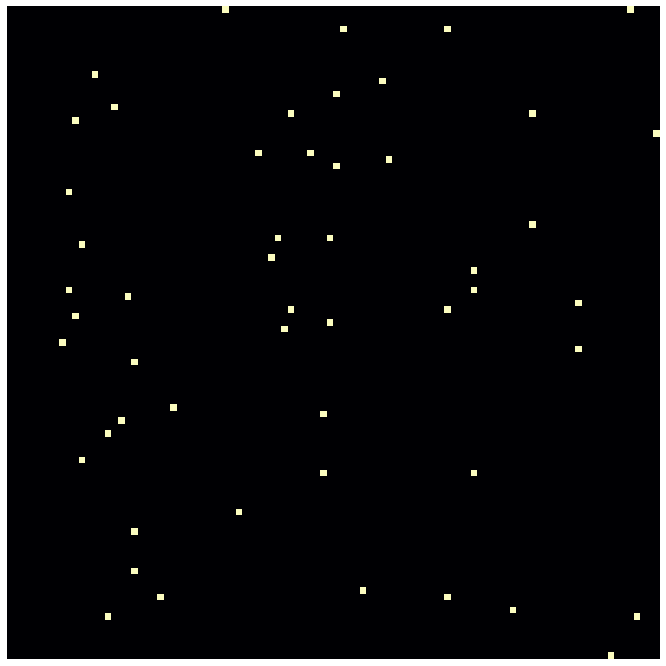

In [ ]:
make_ani(A, colormap='magma') #animation is shown/plotted below

For the animation above: the code creates an animation from the frames stored in 'A', visually demonstrating the spread of fire and vegetation growth over the simulation steps

# Nonlinear Waves

In [ ]:
#the following variables are initialized
w = np.random.random((100,100)) < 0.1 #a 100x100 array is initialized representing an initial state of the world grid for simulation
f = np.matrix([[1,1,1],[1,0,1],[1,1,1]]) #a 3x3 matrix is initialized representing the filter/kernel for the simulation

t  = 6  #center value=6; 7 makes fast pattern; 5 analiating waves
t1 = 3  #center value=3

steps = 1000 #the number of time steps the simulation will run for
A = torch.zeros((steps,100,100)) # storage for frames for animation
w = torch.from_numpy(w)[None,None,:,:] #the world grid is converted to a pytorch tensor
f = torch.from_numpy(f)[None,None,:,:] #the filter/kernel is converted to a pytorch tensor

In [ ]:
#12
for i in range(1000):

    n = (w>0)&(w<t)

    n = conv2(n,f)

    w = ((w==0) & (n>=t1)) \
    +  2*(w==1)            \
    +  3*(w==2)            \
    +  4*(w==3)            \
    +  5*(w==4)            \
    +  6*(w==5)            \
    +  7*(w==6)            \
    +  8*(w==7)            \
    +  9*(w==8)            \
    +  0*(w==9)            \

    A[i] = w

#12
This represents a cellular automation where the state of each cell evolves over 1000 iterations based on its current state and the state of its neighbors.

In the for loop, the first line creates a boolean array. It tells us that the cells are alive and below a certain age threshold

The next line is a convolution operator where it calculates the number of alive neighbors for each cell in the grid based on the filter. Then the resulting array represents the number the number of neighboring cells that are alive and below the age threshold

The following lines where 'w' are defined as the world grid with certain conditions:

  The next lines update the state of the world grid w based on certain rules:

((w==0) & (n>=t1)): This part represents cells that are currently dead (w == 0) and have at least t1 living neighbors (n >= t1). These cells become alive in the next iteration.

2*(w==1), 3*(w==2), ..., 9*(w==8): These parts represent cells that are currently alive with ages ranging from 1 to 8. Each part assigns a new age to the corresponding cells. For example, cells with age 1 become age 2, cells with age 2 become age 3, and so on.

0*(w==9): This part represents cells that are currently alive with age 9. These cells die and become empty in the next iteration.

A[i] = w: This line stores the updated state of the world grid w in the i-th frame of the animation tensor A. Each frame represents a snapshot of the world grid at a particular time step.

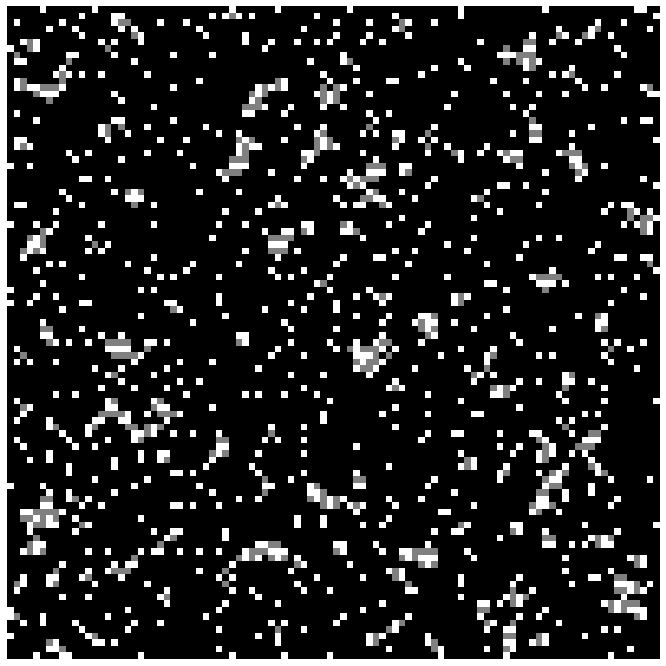

In [ ]:
make_ani(A) #animation is  plotted

For the animation above: the code iterates over each frame in A, where each frame represents a snapshot of the cellular automaton grid at a specific iteration. It then displays these frames sequentially, creating an animation that visualizes the evolution of the cellular automaton over time. the result of the animation is that resembling of a wave

# Wireworld

In [ ]:
#Wireword Wire
#{empty=0 electron_head=1 electron_tail=2, wire=3} #each numerical value corresponds to a specific state or type within a system
#These numerical representations allow for easier manipulation and processing of the system's states within the code.

In [ ]:
#the following variables are initialized
w = np.zeros((100,100)) #initial world grid for the simulation
w[50,:] = 3 #sets the values of the entire 51st row of the grid 'w' to 3
w[50,5] = 2 #sets the values of the entire 51st row of the grid 'w' to 2
w[50,6] = 1 #sets the values of the cell at row 51 and column 7 of the grid 'w' to 1

f = np.matrix([[1,1,1],[1,0,1],[1,1,1]]) #initializes a 3x3 matrix representing the filter/kernel for the simulation

steps = 1000 #the simulation will run for 1000 iterations
A = torch.zeros((steps,100,100)) # storage for frames for animation
w = torch.from_numpy(w)[None,None,:,:] #initial world grid is converted to a pytorch tensor
f = torch.from_numpy(f)[None,None,:,:] #filter/kernel is converted to a pytorch tensor

In [ ]:
#14
for i in range(100):

    n=w==1

    n = conv2(n,f)

    w = 1*((w==3)& ((n==1) | (n==2)))                 \
    +   3*((w==3)& ((n!=1) & (n!=2)))                 \
    +   0*(w==0)                    \
    +   2*(w==1)                    \
    +   3*(w==2)                    \

    A[i] = w

#14
This code appears to simulate a cellular automaton model, where the grid w represents the state of cells at each time step. Let's break down what happens in each step of the loop:

n=w==1: This line creates a boolean array n where True indicates cells that are currently in state 1 (alive) in the grid w.

n = conv2(n,f): This line convolves the boolean array n with a filter/kernel f. This convolution operation calculates the number of alive neighbors for each cell in the grid based on the filter f. The resulting array n represents the number of neighboring cells that are currently alive.

The next lines update the state of the world grid w based on certain rules:

1*((w==3)& ((n==1) | (n==2))): This part represents cells that are currently in state 3 (possibly representing a specific condition) and have 1 or 2 alive neighbors. These cells transition to state 1 in the next iteration.

3*((w==3)& ((n!=1) & (n!=2))): This part represents cells that are currently in state 3 and do not have 1 or 2 alive neighbors. These cells remain in state 3 in the next iteration.

0*(w==0): This part represents cells that are currently in state 0 (empty). These cells remain empty in the next iteration.

2*(w==1): This part represents cells that are currently in state 1 (alive). These cells remain in state 1 in the next iteration.

3*(w==2): This part represents cells that are currently in state 2. These cells remain in state 2 in the next iteration.

A[i] = w: This line stores the updated state of the world grid w in the i-th frame of the animation tensor A. Each frame represents a snapshot of the world grid at a particular time step.

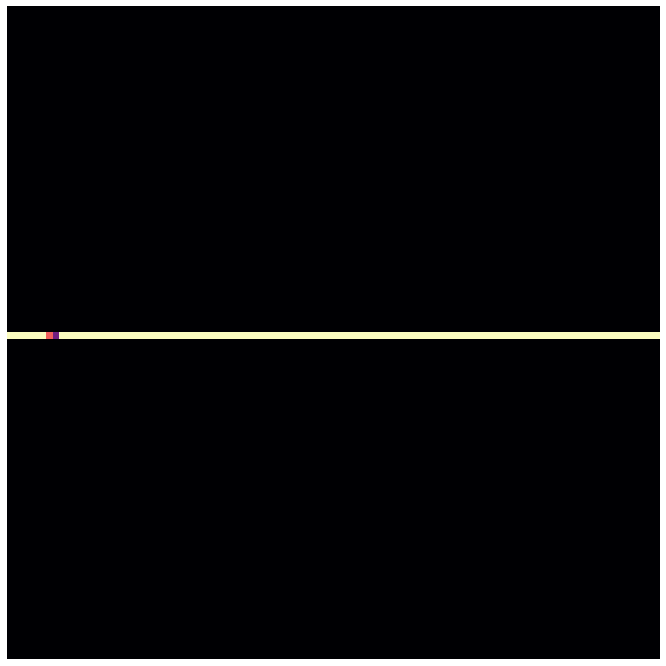

In [ ]:
make_ani(A, colormap='magma') #animation is plotted

For animation above: the code captures the dynamics of the wireworld system, where electrons move along wires and interact with each other according to predefined rules, resulting in a visually dynamic animation of the system's behavior.

In [ ]:
#Wireworld Oscillator

In [ ]:

w = np.zeros((100,100)) #the initial state of the world grid is initialized as a 100x100 array
w[50,15:-1] = 3 #a condition where it sets the values of cells in the 51st row and from the 15th column to the second-to-last column to 3
w[48,5:15] = 3 #a condition where it sets the values of cells in the 49th row and from the 5th column to the 14th column to 3
w[52,5:15] = 3 #a condition where it sets the values of cells in the 53rd row and from the 5th column to the 14th column to 3.
w[49:52,4] = 3 #a condition where it sets the values of cells in rows 50 to 52 and the 5th column to
w[49:52,15] = 3 #a condition where it sets the values of cells in rows 50 to 52 and the 16th column to 3.
w[52,14] = 1 #a condition where it  sets the value of the cell at row 53 and column 15 to 1
w[52,13] = 2 #a condition where it sets the value of the cell at row 53 and column 14 to 2

f = np.matrix([[1,1,1],[1,0,1],[1,1,1]]) #the filter/kernel initializes a 3x3 matrix where each cell has a weight of 1, except for the center cell, which has a weight of 0

steps = 1000 #number of steps for the simulation
A = torch.zeros((steps,100,100)) # storage for frames for animation
w = torch.from_numpy(w)[None,None,:,:] #This line converts the variable w (presumably representing the initial world grid for the simulation) to a PyTorch tensor and adds two additional dimensions at the beginning.
f = torch.from_numpy(f)[None,None,:,:] #this line converts the variable f (presumably representing the filter/kernel for the simulation) to a PyTorch tensor and adds two additional dimensions at the beginning.

In [ ]:
#15
for i in range(steps):

    n = w == 1

    n = conv2(n,f)

    w = 0*((w==0))                                    \
    +   2*((w==1))                                    \
    +   3*((w==2))                                    \
    +   3*((w==3)& ((n!=1) & (n!=2)))                 \
    +   1*((w==3)& ((n==1) | (n==2)))                 \

    A[i] = w

#15
This code appears to simulate a cellular automaton model. Here's a breakdown of the mathematical operations happening in each step:

n = w == 1: This line creates a boolean array n where True indicates cells that are currently in state 1 (alive) in the grid w.
n = conv2(n, f): This line convolves the boolean array n with a filter/kernel f. This convolution operation calculates the number of alive neighbors for each cell in the grid based on the filter f. The resulting array n represents the number of neighboring cells that are currently alive.

The next lines update the state of the world grid w based on certain rules:
0*((w==0)): This part represents cells that are currently in state 0 (empty). These cells remain empty in the next iteration.

2*((w==1)): This part represents cells that are currently in state 1 (alive). These cells remain in state 1 in the next iteration.

3*((w==2)): This part represents cells that are currently in state 2. These cells remain in state 2 in the next iteration.

3*((w==3)& ((n!=1) & (n!=2))): This part represents cells that are currently in state 3 (possibly representing a specific condition) and do not have 1 or 2 alive neighbors. These cells transition to state 3 in the next iteration.

1*((w==3)& ((n==1) | (n==2))): This part represents cells that are currently in state 3 and have 1 or 2 alive neighbors. These cells transition to state 1 in the next iteration.

A[i] = w: This line stores the updated state of the world grid w in the i-th frame of the animation tensor A. Each frame represents a snapshot of the world grid at a particular time step.

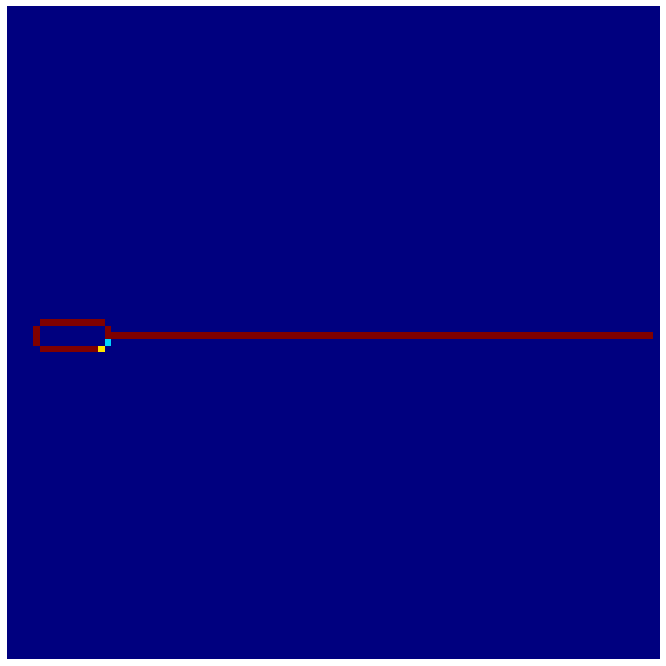

In [ ]:
make_ani(A, colormap='jet') #animation is plotted

For animation above: In the wireworld cellular automaton, oscillation occurs due to the interplay between different types of cells and their interactions based on specific rules. Specifically, the oscillation is caused by the periodic transformation of electron heads (1) into electron tails (2), and vice versa, along with the propagation of conductive wires (3) through the grid, which creates a cyclic pattern of behavior

# Raindrops

In [ ]:
#packages were described already in the first cell that mentions it
import numpy as np
from skimage import io as io
import matplotlib.pyplot as plt
from scipy import signal
import torch.nn.functional as F
from torch.nn.functional import *
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import time
from matplotlib import animation, rc
from IPython.display import HTML
rc('animation', html='html5')

In [ ]:
#16
def make_ani(A, colormap='gray'):

    fig, ax = plt.subplots()
    im = ax.imshow(A[0,:,:], cmap = colormap);
    ax.axis('off')
    fig.set_size_inches(12, 12)

    def animate(data, im):
        im.set_data(data)

    def step():
        for i in range(A.shape[0]):
            data = A[i,:,:]
            yield data

    return animation.FuncAnimation(fig, animate, step, interval=100, repeat=True, fargs=(im,))

#16
This code defines a function make_ani that creates an animation from a sequence of frames A. Here's a breakdown of what each part does:

fig, ax = plt.subplots(): This line creates a new figure and axes for plotting.

im = ax.imshow(A[0,:,:], cmap=colormap): This line initializes an image plot (imshow) with the first frame of the input array A. The colormap used for plotting is specified by the colormap argument.

ax.axis('off'): This line turns off the axis labels and ticks for the plot.

fig.set_size_inches(12, 12): This line sets the size of the figure in inches.

def animate(data, im): ...: This defines a function animate that updates the image plot with new data.

def step(): ...: This defines a generator function step that yields each frame of the input array A one at a time.

return animation.FuncAnimation(fig, animate, step, interval=100, repeat=True, fargs=(im,)): This returns a FuncAnimation object that animates the frames. It takes several arguments:

fig: The figure to animate.


animate: The function that updates the plot with new data.

step: The generator function that yields each frame of the animation.

interval: The time interval between frames in milliseconds.

repeat: Whether to repeat the animation.

fargs: Additional arguments to pass to the animate function, in this case, the im object representing the image plot.

In [ ]:
#17
def plot(x):
    fig, ax = plt.subplots()
    im = ax.imshow(x, cmap = 'gray')
    ax.axis('off')
    fig.set_size_inches(15, 15)
    plt.show()

#17
This function, plot(x), is designed to plot a 2D array x as an image. Here's what each line does:

fig, ax = plt.subplots(): This creates a new figure and axes for plotting.

im = ax.imshow(x, cmap='gray'): This line plots the 2D array x as an image on the axes ax. The imshow function is used for displaying images, and the colormap 'gray' is specified to display the image in grayscale.

ax.axis('off'): This turns off the axis labels and ticks for the plot, making it more suitable for displaying images without additional clutter.

fig.set_size_inches(15, 15): This sets the size of the figure to 15x15 inches.

plt.show(): This displays the plot. This line is necessary to actually see the image on the screen.

In [ ]:
#18
def scale_clip(a):
    # rng=[0,1]
    rng=[-0.01, 0.01]
    a = (a - rng[0])/float(rng[1] - rng[0])*255
    a = torch.clip(a, 0, 255).int()
    return a

#18
This function scale_clip(a) appears to perform scaling and clipping operations on a tensor a. Here's the breakdown:

rng=[-0.01, 0.01]: This line defines a range [min_val, max_val] within which the input tensor a will be scaled.

a = (a - rng[0])/float(rng[1] - rng[0])*255: This line scales the values of the tensor a to the range [0, 255]. It subtracts the minimum value rng[0] from each element of a, divides by the range of values (rng[1] - rng[0]), and then scales the result by 255. This operation maps the input values to the range [0, 255].

a = torch.clip(a, 0, 255).int(): This line clips the values of the tensor a to ensure they fall within the range [0, 255]. Values below 0 are set to 0, and values above 255 are set to 255. Additionally, the .int() method converts the tensor to integers, as the pixel values in images are typically represented as integers.

return a: This line returns the scaled and clipped tensor a.

In [ ]:
#19
def laplacian(U):
    U = pad(U, (1, 1, 1, 1))
    n = conv2d(U,laplace)
    return n

#19
This function laplacian(U) seems to be implementing the Laplacian operator on an input tensor U. Here's the breakdown:

U = pad(U, (1, 1, 1, 1)): This line pads the input tensor U with zeros on all sides. The (1, 1, 1, 1) argument indicates padding of 1 pixel width on each side of the tensor in all dimensions. Padding is often done before applying convolution operations to prevent the loss of information at the edges of the image.

n = conv2d(U, laplace): This line performs a 2-dimensional convolution operation on the padded tensor U using a Laplacian kernel laplace. The Laplacian kernel is a discrete convolution kernel that is commonly used for edge detection and image sharpening. It highlights regions of rapid intensity change in an image.

return n: This line returns the result of the convolution operation, which represents the Laplacian-transformed version of the input tensor U.

A convolution is made from applying a Laplacian distribution

In [ ]:
#a Laplacian kernel is defined and converts it to a Pytorch tensor suitable for GPU processing
laplace = 0.5*np.array([[0.5, 1.0, 0.5],
                        [1.0, -6., 1.0],
                        [0.5, 1.0, 0.5]]) #This line creates a Laplacian kernel matrix as a NumPy array.

laplace = torch.from_numpy(laplace)[None,None,:,:].type(torch.float).cuda() #This line converts the Laplacian kernel from a NumPy array to a PyTorch tensor suitable for GPU processing

In [ ]:
N = 256 #N is defined representing the size of the grid

In [ ]:
h = 0.03 #step size is defined
damping = 0.04 #Damping usually refers to the process of reducing the magnitude or oscillations of a system over time.
#In various contexts such as physics simulations or signal processing, damping coefficients control the rate at which oscillations diminish in a system.
#A higher damping coefficient means faster reduction in oscillations.

In [ ]:
u_init = np.zeros([N, N], dtype=np.float32)
ut_init = np.zeros([N, N], dtype=np.float32)

for n in range(6):
  a,b = np.random.randint(0, N, 2)
  u_init[a,b] = np.random.uniform()

U = torch.from_numpy(u_init)[None,None,:,:].cuda()
Ut = torch.from_numpy(ut_init)[None,None,:,:].cuda()

steps = 40000
skip = 10
P = torch.zeros((steps//skip,N,N))

j = 0

for i in range(steps):

    Ut += h * (laplacian(U) - damping * Ut)
    U  += h * Ut

    if i % skip == 0:
        P[j] = scale_clip(U)
        j += 1

#20
This code snippet seems to be performing a numerical simulation of a physical system, likely a partial differential equation (PDE) system, using a finite difference method. Let's break it down:

Initialization:
u_init and ut_init are initialized as arrays of zeros with shape [N, N], where N is a variable presumably representing the size of the grid or domain. These arrays will store the initial state of the system and its time derivative, respectively.

A loop iterates n from 0 to 5, where at each iteration, it randomly selects a position (a, b) within the grid and assigns a random value to u_init[a, b]. This step initializes the system with random values at some locations.

U and Ut are created as PyTorch tensors from u_init and ut_init, respectively. They are moved to the GPU for computation (cuda()).
steps and skip are defined to control the simulation parameters. steps defines the total number of simulation steps, and skip determines how often the system state is recorded.

Main Simulation Loop:
Inside the loop iterating from 0 to steps - 1:
Ut is updated using the time derivative of U calculated by applying the Laplacian operator (presumably representing diffusion) and damping terms. This update follows a finite difference method, where the Laplacian is calculated using the laplacian function.
U is updated using the new time derivative Ut.
Every skip steps, the current state of U is scaled and clipped (possibly for visualization or analysis purposes) and stored in the P tensor at index j. Then, j is incremented to move to the next index in P.

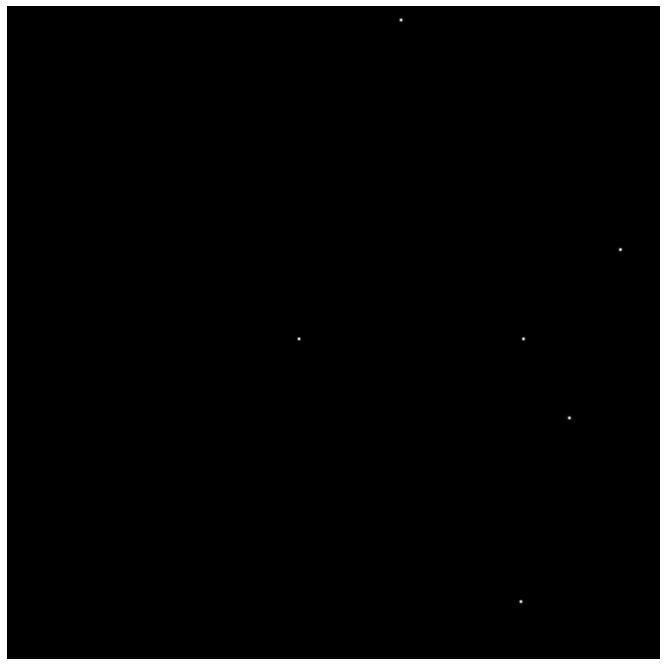

In [ ]:
make_ani(P) #animation is plotted

For animation above: As the simulation progresses, the changes in the terrain grid are visualized using animations or static images. The animation shows the dynamic evolution similar to 'rain drops'

# PDE

In [ ]:
#FitzHugh-Nagumo Reaction Diffusion

In [ ]:
#21
def laplacian(U):
    n = conv2d(U,laplace)
    n = pad(n, (1, 1, 1, 1),'circular')
    return n

#21
This function laplacian(U) computes the Laplacian of a two-dimensional input tensor U. The Laplacian operator is a second-order differential operator that describes the divergence of the gradient of a scalar function. It is often used in physics and mathematics to describe phenomena such as heat conduction, fluid flow, and diffusion.

Here's a breakdown of the code:

Convolution with Laplacian Kernel:
n = conv2d(U, laplace): This line convolves the input tensor U with a Laplacian kernel laplace. The Laplacian kernel is a discrete convolution filter that approximates the Laplacian operator in discrete space. Convolution is a mathematical operation that combines two functions to produce a third function representing how one function modifies the other. In this case, convolution is used to compute the Laplacian of the input tensor.

Padding:
n = pad(n, (1, 1, 1, 1), 'circular'): After convolution, padding is applied to the result n. Padding is the process of adding additional elements around the edges of an array to ensure that convolution operations do not alter the dimensions of the input. Here, circular padding is used, which wraps the values around from one edge of the array to the other.

Return:
return n: The padded result n is returned from the function as the Laplacian of the input tensor U.

In [ ]:
laplace = 0.5*np.array([[0.5, 1.0, 0.5],
                        [1.0, -6., 1.0],
                        [0.5, 1.0, 0.5]]) #This line creates a Laplacian kernel matrix as a NumPy array.

In [ ]:
#22
N = 256
h = 0.05

A = np.zeros([N, N], dtype=np.float32)

A = A + -0.7

noise_shape = A[:,120:130].shape

A[:,120:130] = (np.random.normal(0.9,0.05,size=noise_shape))

B = np.zeros([N, N], dtype=np.float32)

B = B + -0.3

#22
This code appears to be creating two matrices, A and B, with dimensions N x N, where N is 256. Let's break down the operations:

Initialization:
N = 256: This sets the variable N to 256, indicating that the matrices A and B will have dimensions 256 x 256.

h = 0.05: This sets the variable h to 0.05. The purpose of this variable is not clear from the provided code snippet, as it is not utilized further.
Matrix A

Initialization:
A = np.zeros([N, N], dtype=np.float32): This creates a matrix A filled with zeros of size N x N.

A = A + -0.7: This adds a constant value of -0.7 to every element of matrix A. This operation effectively initializes A with the value -0.7 for all elements.

Noise Addition to A:
noise_shape = A[:,120:130].shape: This line retrieves the shape of a subset of columns from matrix A, specifically columns 120 to 129. The purpose of this line seems to be preparing to add noise to a specific region of A.

A[:,120:130] = (np.random.normal(0.9,0.05,size=noise_shape)): This line adds noise to the subset of columns in A (columns 120 to 129) by drawing random samples from a normal distribution with mean 0.9 and standard deviation 0.05. The noise is added only to this specific region.

Matrix B Initialization:
B = np.zeros([N, N], dtype=np.float32): This creates a matrix B filled with zeros of size N x N.

B = B + -0.3: This adds a constant value of -0.3 to every element of matrix B. This operation effectively initializes B with the value -0.3 for all elements.

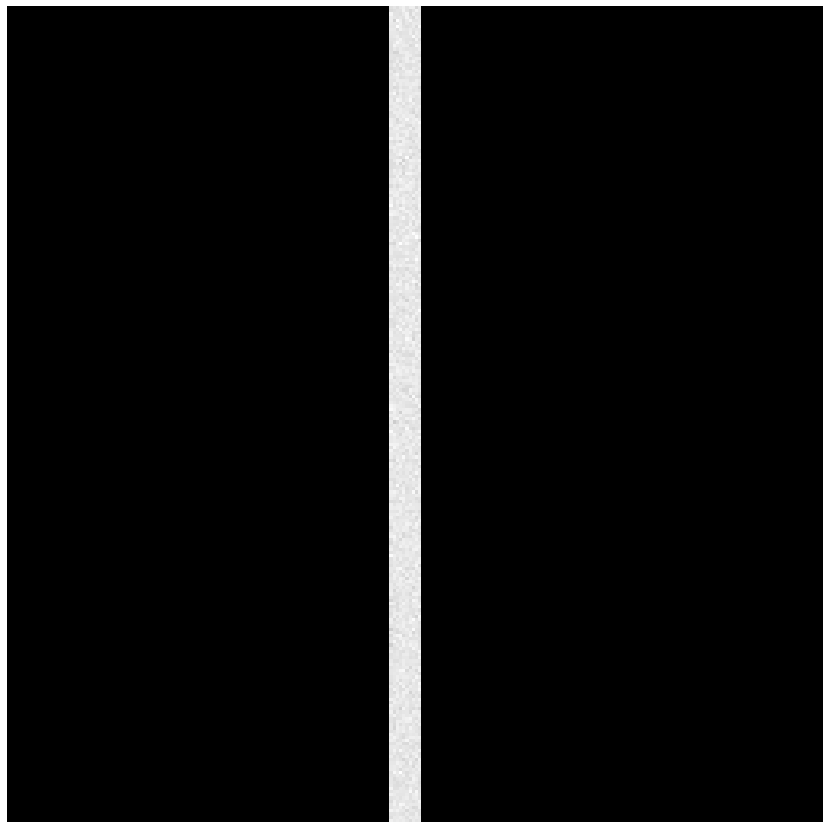

In [ ]:
w1 = plot(A) #animation is plotted

For image above: The code sets up Laplacian filtering, initializes matrices with specific values, adds noise to one of the matrices, and then visualizes the result. A larger image processing is shown as a result

In [ ]:
#constants are defined
a0 = -0.1
a1 = 2
epsilon = 0.05
delta = 4
k1 = 1
k2 = 0
k3 = 1

In [ ]:
A = torch.from_numpy(A)[None,None,:,:].cuda() #converts numpy array to a pytorch tensor
B = torch.from_numpy(B)[None,None,:,:].cuda() #converts numpy array to a pytorch tensor
laplace = torch.from_numpy(laplace)[None,None,:,:].type(torch.float).cuda() #This line does the same as the previous two lines but with an additional step.
#type(torch.float): Converts the tensor's data type to float. This ensures compatibility with other float tensors in PyTorch.

In [ ]:
steps = 100 #number of iterations for simulation
P = torch.zeros((steps,N,N)) # storage for frames for animation

In [ ]:
#23
j = 0
for i in range(steps*1000):

    A += h*( k1*A - k2*A**2 - A**3 - B + laplacian(A))
    B += h*( epsilon*(k3*A - a1*B -a0) + delta*laplacian(B)     )

    if i % 1000 == 0:
        P[j] = A
        j += 1

#23
This code snippet appears to be performing a numerical simulation of a dynamical system governed by a set of differential equations. Let's break down the main components:

Initialization:
j = 0: Initialize an index variable j to 0.

for i in range(steps*1000): This loop iterates over a large number of time steps, determined by steps*1000. It's likely that steps is the total number of steps and 1000 is the frequency at which results are recorded.

Dynamical Equations:
A and B represent the state variables of the system. They are updated at each time step according to a set of differential equations.

A += h*( k1*A - k2*A**2 - A**3 - B + laplacian(A)): Update equation for variable A. It's a combination of linear and nonlinear terms, including diffusion (represented by laplacian(A)).

B += h*( epsilon*(k3*A - a1*B -a0) + delta*laplacian(B) ): Update equation for variable B. Similar to A, it includes linear and nonlinear terms, along with diffusion.

Recording Results:
if i % 1000 == 0: This condition checks if the current time step is a multiple of 1000 (i.e., if it's time to record the results). If true, the current state of A is stored in the array P, and the index j is incremented.

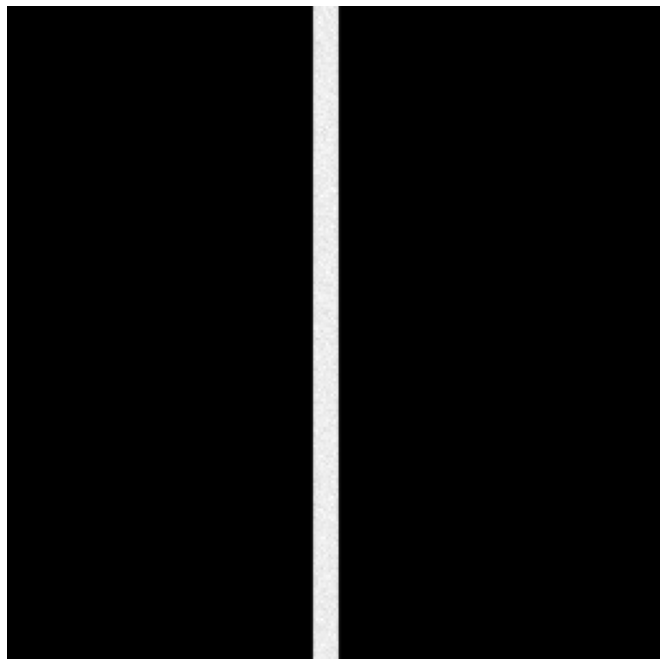

In [ ]:
make_ani(P) #animation is plotted

For animation above: This would cause a change in dynamic motion from the original image resulting in the animation shown

In [ ]:
#Gray Scott Reaction Diffusion

In [ ]:
laplace = 0.5*np.array([[0.5, 1.0, 0.5],
                        [1.0, -6., 1.0],
                        [0.5, 1.0, 0.5]]) #This line creates a Laplacian kernel matrix as a NumPy array.

In [ ]:
laplace = torch.from_numpy(laplace)[None,None,:,:].type(torch.float).cuda() #This line does the same as the previous two lines but with an additional step.
#type(torch.float): Converts the tensor's data type to float. This ensures compatibility with other float tensors in PyTorch.

In [ ]:
#24
def laplacian(U):
    n = conv2d(U,laplace)
    n = pad(n, (1,1,1,1))
    n = pad(n, (0,0,0,0))
    return n

#24
This code defines a function laplacian(U) that computes the Laplacian of a two-dimensional input tensor U. Let's break down the operations:

Convolution with Laplacian Kernel:
n = conv2d(U, laplace): This line convolves the input tensor U with a Laplacian kernel laplace. The Laplacian kernel is a discrete convolution filter that approximates the Laplacian operator in discrete space. Convolution is a mathematical operation that combines two functions to produce a third function representing how one function modifies the other. In this case, convolution is used to compute the Laplacian of the input tensor.

Padding:
n = pad(n, (1, 1, 1, 1)): After convolution, padding is applied to the result n. Padding is the process of adding additional elements around the edges of an array to ensure that convolution operations do not alter the dimensions of the input. Here, padding of 1 pixel is added on all sides of the result n.

Additional Padding:
n = pad(n, (0, 0, 0, 0)): Further padding is applied to the result n. This additional padding does not change the size of n and is likely unnecessary unless there's a specific requirement for the output shape.

Return:
return n: The padded result n is returned from the function as the Laplacian of the input tensor U.

In [ ]:
# (Du, Dv, F, k) = ((0.16, 0.08, 0.035, 0.065)) # Bacteria 1
# (Du, Dv, F, k) = ((0.14, 0.06, 0.035, 0.065)) # Bacteria 2
# (Du, Dv, F, k) = ((0.16, 0.08, 0.060, 0.062)) # Coral
(Du, Dv, F, k) = ((0.19, 0.05, 0.060, 0.062)) # Fingerprint
# (Du, Dv, F, k) = ((0.10, 0.10, 0.018, 0.050)) # Spirals
# (Du, Dv, F, k) = ((0.12, 0.08, 0.020, 0.050)) # Spirals Dense
# (Du, Dv, F, k) = ((0.10, 0.16, 0.020, 0.050)) # Spirals Fast
# (Du, Dv, F, k) = ((0.16, 0.08, 0.020, 0.055)) # Unstable
# (Du, Dv, F, k) = ((0.16, 0.08, 0.050, 0.065)) # Worms 1
# (Du, Dv, F, k) = ((0.16, 0.08, 0.054, 0.063)) # Worms 2
# (Du, Dv, F, k) = ((0.16, 0.08, 0.035, 0.060)) # Zebrafish
#go back
N = 256

U = np.zeros((N,N)) # Clear Chemicals
V = np.zeros((N,N))

U = U + 1.0
r = 5
U[N//2-r:N//2+r,N//2-r:N//2+r] = 0.50 # Add Disturbance in Center Square Radius r
V[N//2-r:N//2+r,N//2-r:N//2+r] = 0.25

U += 0.05*np.random.random((N,N)) # Add Noise to Chemicals
V += 0.05*np.random.random((N,N))

U = torch.from_numpy(U)[None,None,:,:].type(torch.float).cuda()
V = torch.from_numpy(V)[None,None,:,:].type(torch.float).cuda()

steps = 2000
skip = 100
P = torch.zeros((steps,N,N)) # storage for frames for animation

From the code shown above:

This code segment initializes a reaction-diffusion simulation with the Gray-Scott model. The commented-out lines define parameters for different patterns like bacteria, coral, fingerprints, etc.

Finally, the grid is converted to PyTorch tensors and moved to the GPU for computation. The simulation will run for 2000 steps, with frames stored every 100 steps for later animation

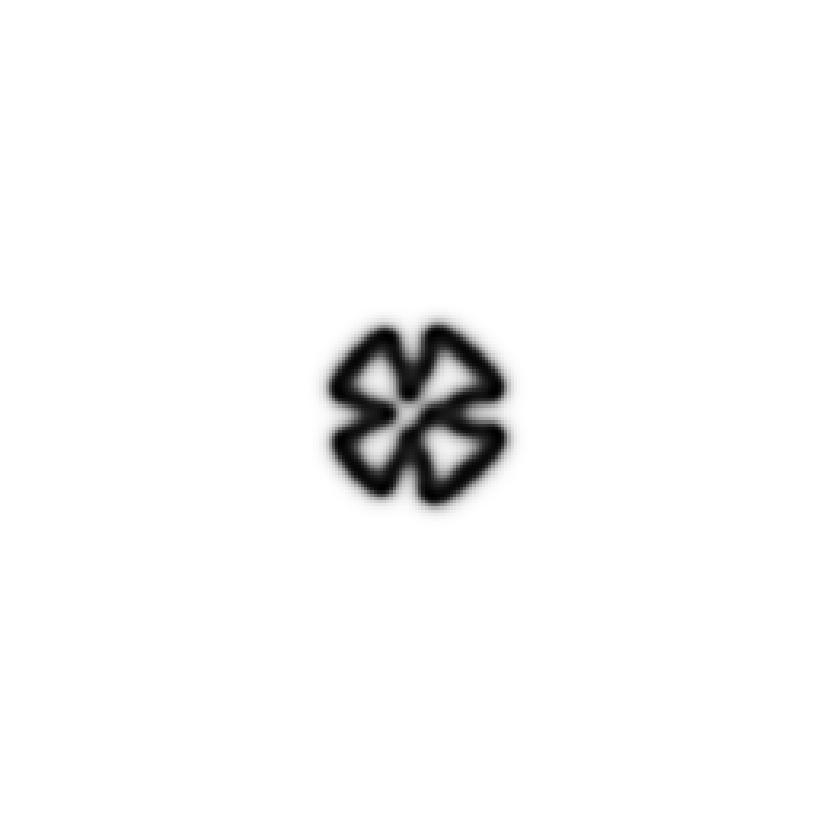

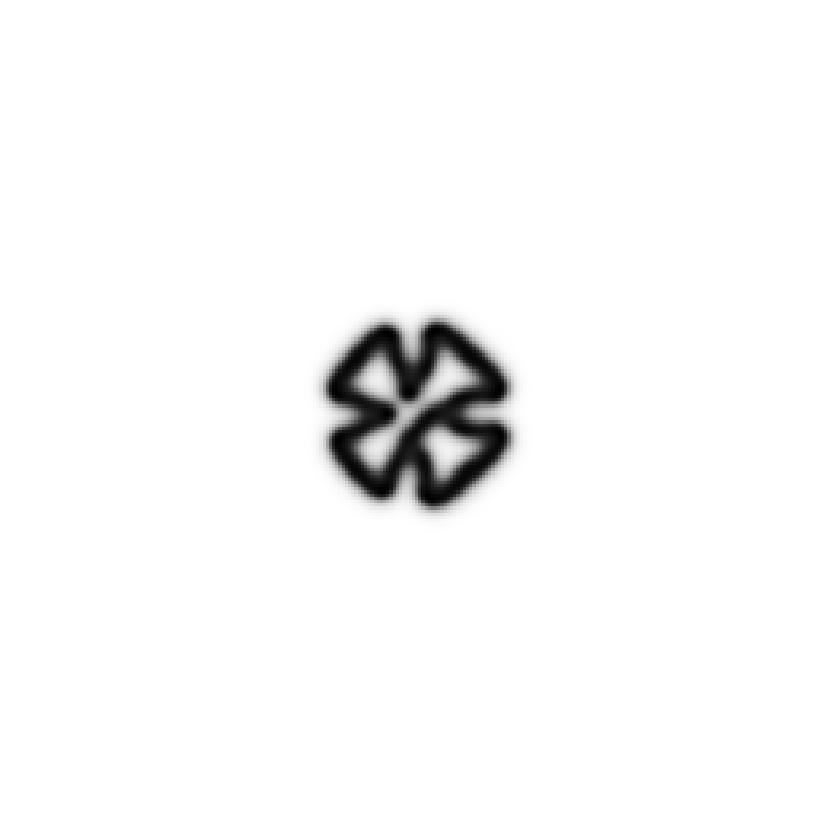

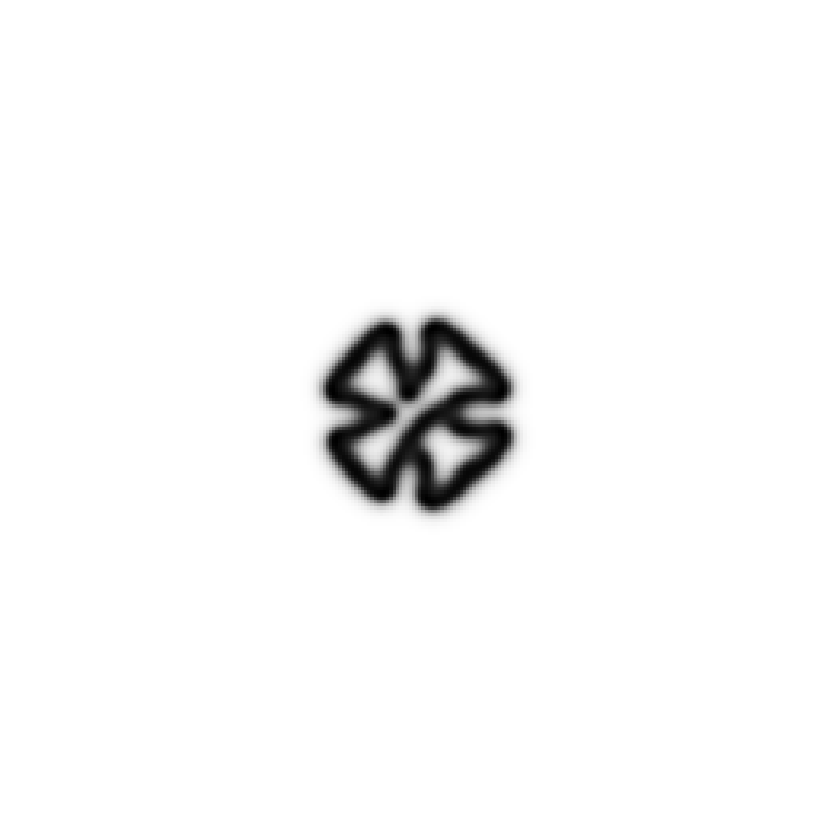

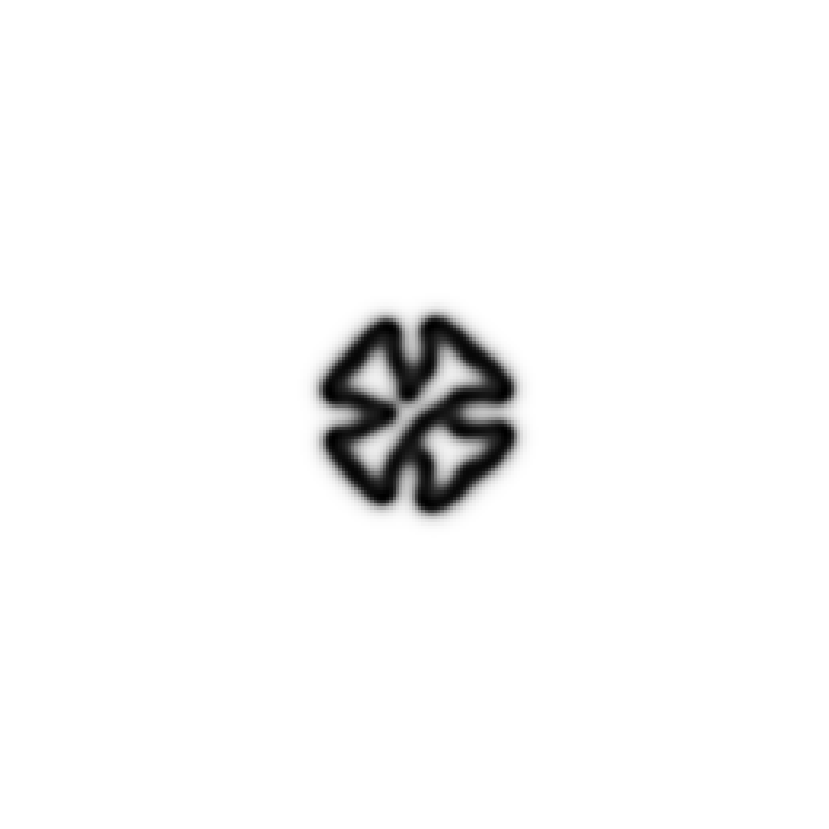

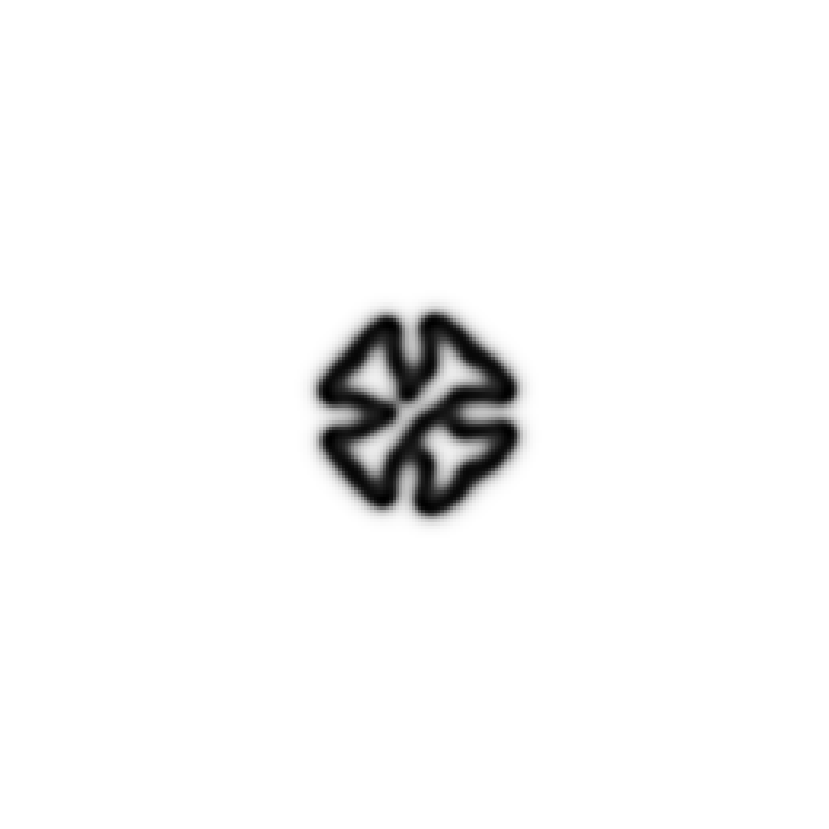

...

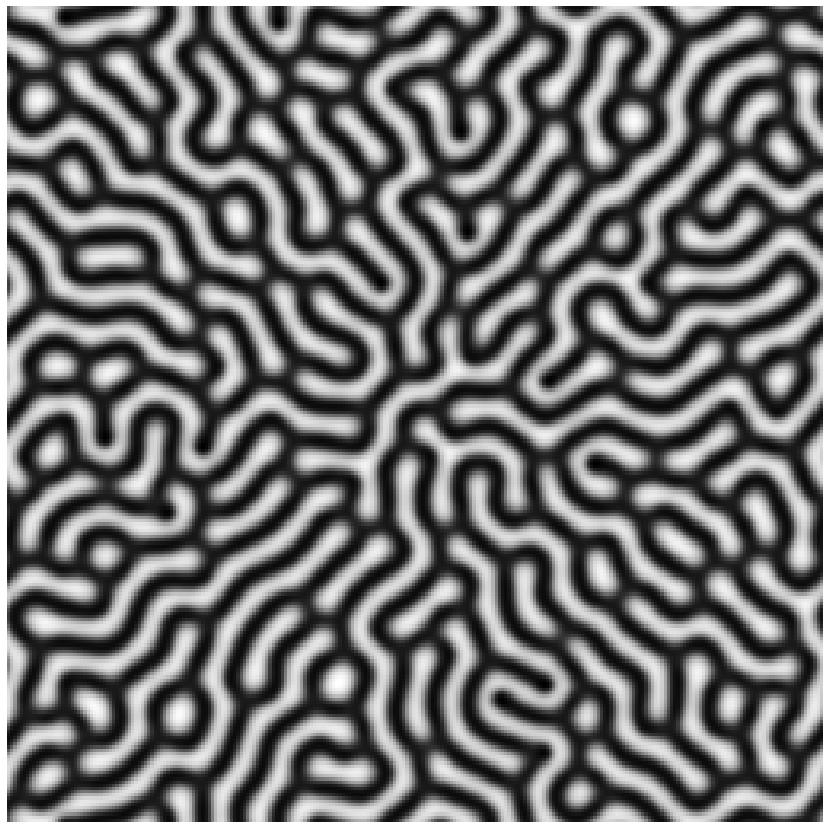

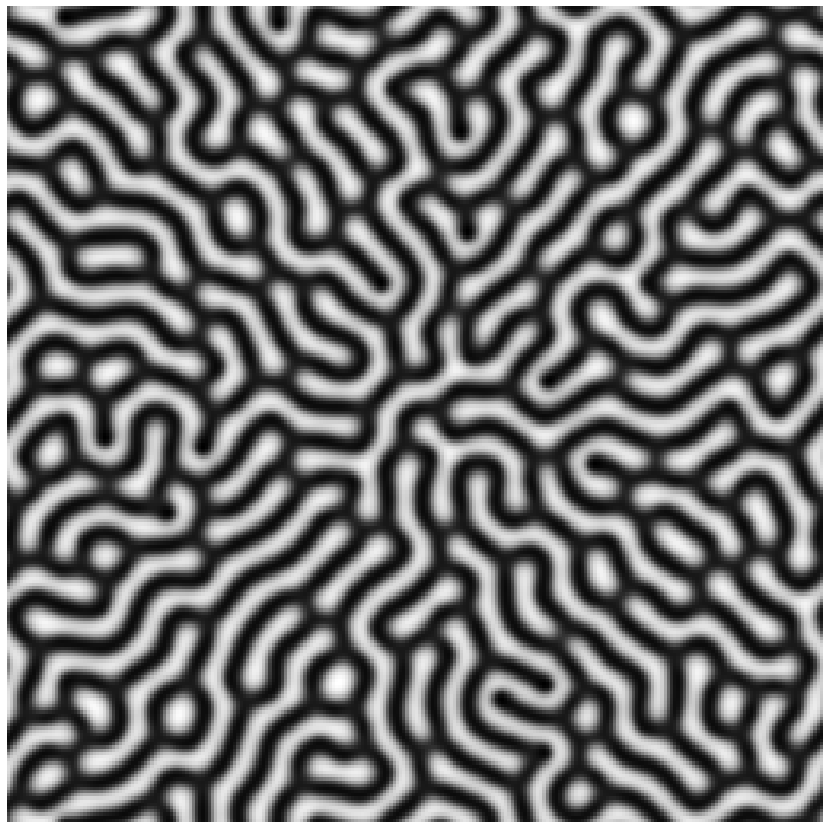

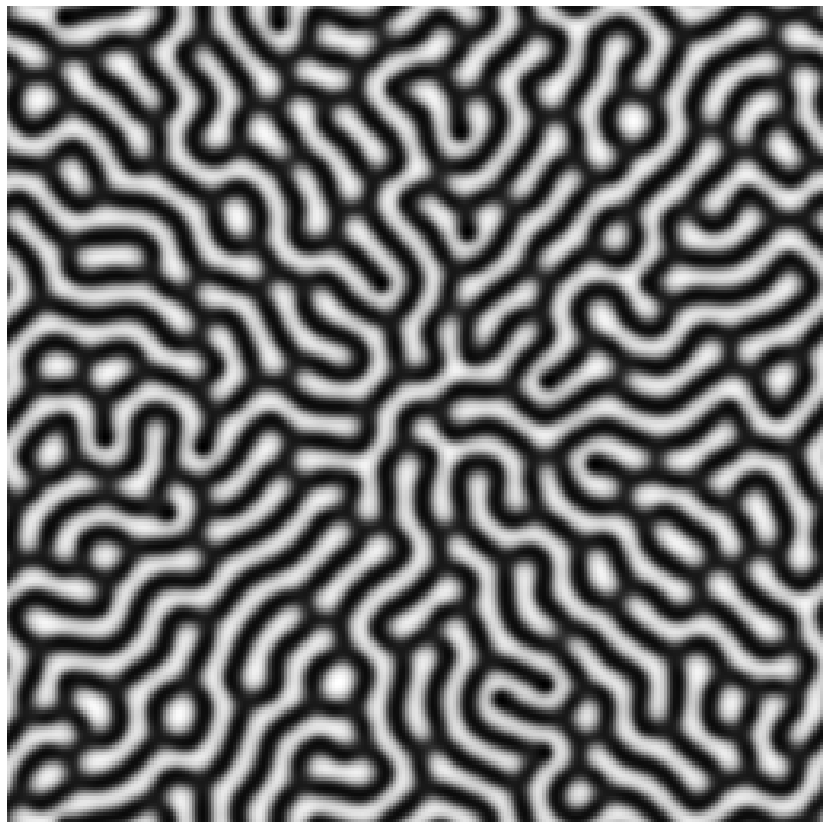

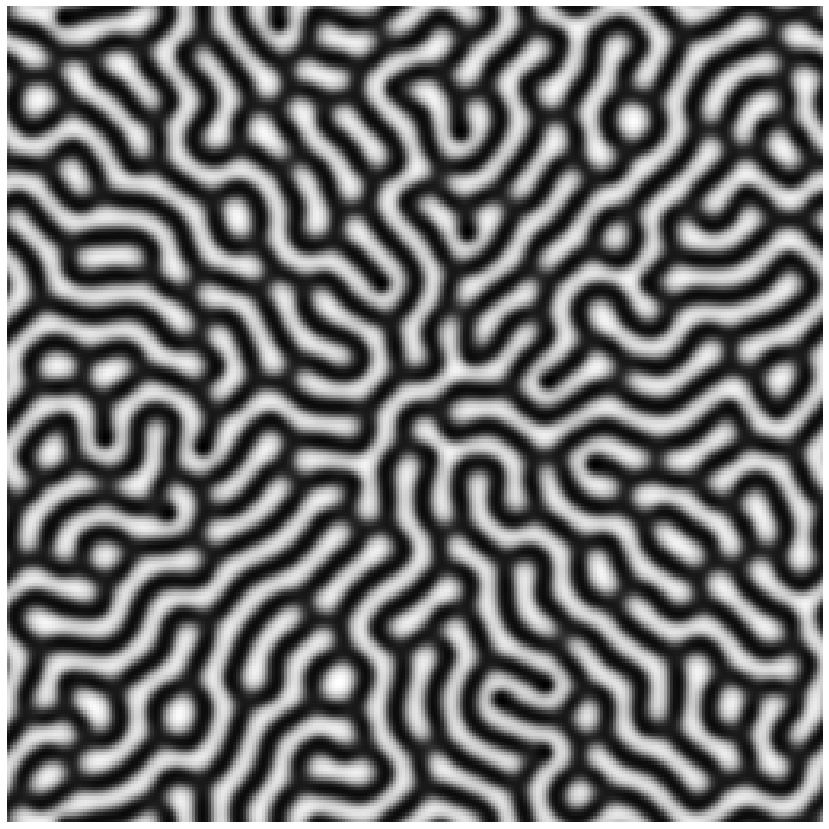

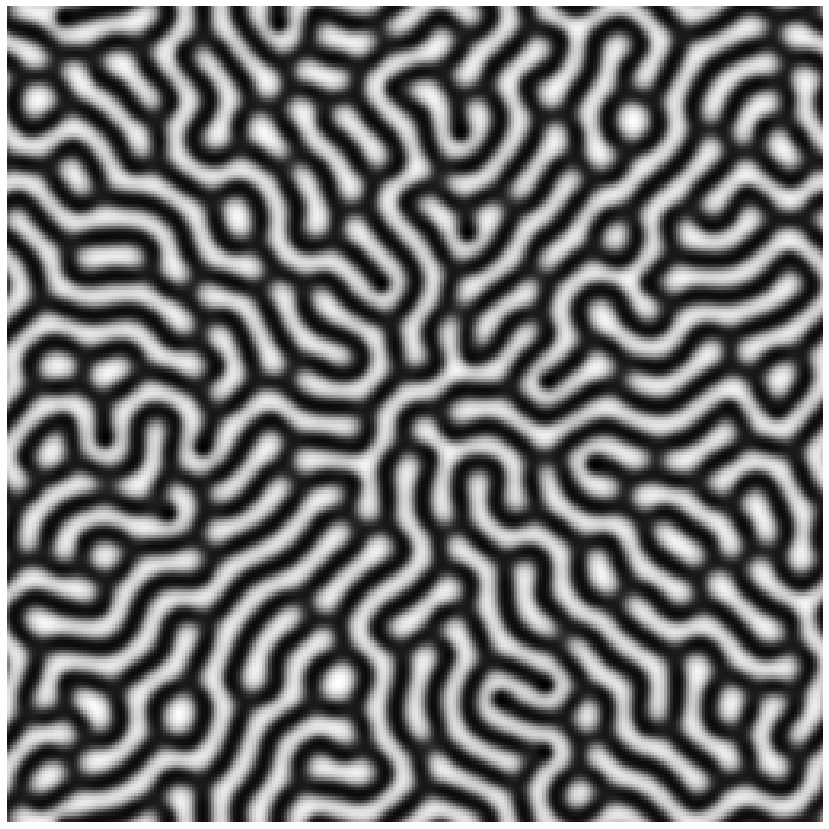

KeyboardInterrupt: ignored

In [ ]:
#25
j = 0
for i in range(steps*skip):

    U += ( Du*laplacian(U) - U*V**2 +  F   *(1-U) )
    V += ( Dv*laplacian(V) + U*V**2 - (F+k)*V     )

    if i % skip == 0:
        P[j] = U
        j += 1
        plot(U[0,0].cpu().detach().numpy())

#25
This code snippet appears to be simulating a reaction-diffusion system governed by the FitzHugh-Nagumo equations or a similar system. Let's break it down:

Initialization:
j = 0: Initialize an index variable j to 0. This variable is used to keep track of the index of the array P where the results are stored.
for i in range(steps*skip): Loop over a large number of time steps, determined by steps*skip.

Reaction-Diffusion Equations:
U and V are variables representing the concentrations of two interacting chemical species.

U += ( Du*laplacian(U) - U*V**2 + F *(1-U) ): This equation represents the change in concentration of species U over time. It includes terms for diffusion (Du*laplacian(U)), reaction (the term - U*V**2 representing an interaction between U and V), and a source term F*(1-U) representing external input or growth.

V += ( Dv*laplacian(V) + U*V**2 - (F+k)*V ): This equation represents the change in concentration of species V over time. It also includes terms for diffusion, reaction, and decay.

Recording Results:
if i % skip == 0: This condition checks if the current time step is a multiple of skip. If true, the current state of U is stored in the array P, and the index j is incremented.

plot(U[0,0].cpu().detach().numpy()): This line plots the current state of U using a function plot(). It converts U to a NumPy array, extracts the necessary data (likely the first channel of the first batch), and then plots it.

By plotting the concentration of
U at different time points during the simulation, you can observe how patterns and structures emerge and evolve over time. These patterns are the result of the interaction between diffusion and reaction processes, and they can resemble various natural phenomena such as waves, spots, stripes, or more complex structures like fingerprints for the resulting images above.

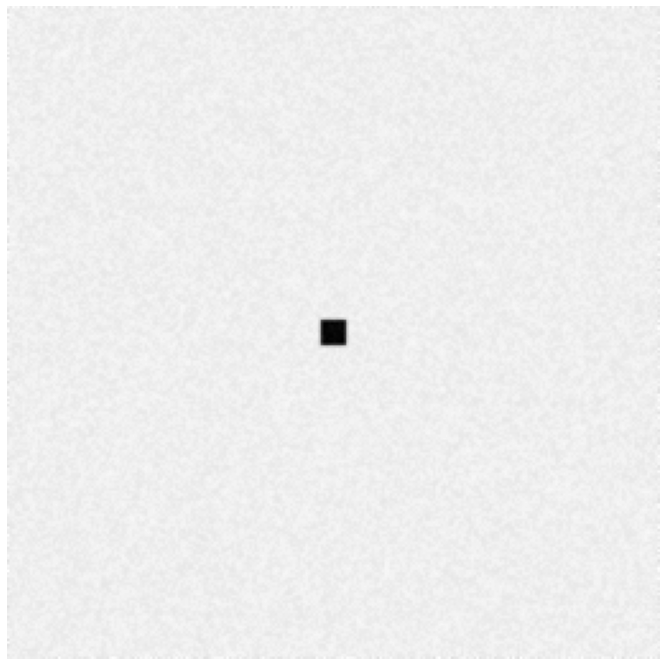

In [ ]:
make_ani(P) #animation is plotted

For the animation above: It visually shows the distribution of the chemical U on the grid at that particular step of the simulation.  At regular intervals (skip steps), the current state of the concentration
U is stored in the tensor
P, and an image representing this state is plotted. These patterns are the result of the interaction between diffusion and reaction processes